# Afriat

In [1]:
scan=0.135

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: hgbi7jwj
Name: jedi-cruiser-100
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/hgbi7jwj
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-hgbi7jwj/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2543,3313,9387
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2543,2569,1669,3471,1638,3353
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4447,10796
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 662,796,2352
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 662,633,439,819,411,846
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1137,2673
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:13:14, 13.35s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:13:14, 13.35s/it, v_num=wj_1, total_loss_train=3.69e+3, kl_local_train=55.6]

Epoch 2/600:   0%|          | 1/600 [00:13<2:13:14, 13.35s/it, v_num=wj_1, total_loss_train=3.69e+3, kl_local_train=55.6]

Epoch 2/600:   0%|          | 2/600 [00:25<2:06:19, 12.67s/it, v_num=wj_1, total_loss_train=3.69e+3, kl_local_train=55.6]

Epoch 2/600:   0%|          | 2/600 [00:25<2:06:19, 12.67s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=82]  

Epoch 3/600:   0%|          | 2/600 [00:25<2:06:19, 12.67s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=82]

Epoch 3/600:   0%|          | 3/600 [00:37<2:03:43, 12.43s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=82]

Epoch 3/600:   0%|          | 3/600 [00:37<2:03:43, 12.43s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=83.1]

Epoch 4/600:   0%|          | 3/600 [00:37<2:03:43, 12.43s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=83.1]

Epoch 4/600:   1%|          | 4/600 [00:49<2:02:30, 12.33s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=83.1]

Epoch 4/600:   1%|          | 4/600 [00:49<2:02:30, 12.33s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=80]  

Epoch 5/600:   1%|          | 4/600 [00:49<2:02:30, 12.33s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=80]

Epoch 5/600:   1%|          | 5/600 [01:02<2:03:34, 12.46s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=80]

Epoch 5/600:   1%|          | 5/600 [01:02<2:03:34, 12.46s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=73.8]

Epoch 6/600:   1%|          | 5/600 [01:03<2:03:34, 12.46s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=73.8]

Epoch 6/600:   1%|          | 6/600 [01:16<2:07:43, 12.90s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=73.8]

Epoch 6/600:   1%|          | 6/600 [01:16<2:07:43, 12.90s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=64.7, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 6/600 [01:16<2:07:43, 12.90s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=64.7, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 7/600 [01:28<2:06:15, 12.78s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=64.7, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 7/600 [01:28<2:06:15, 12.78s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|          | 7/600 [01:28<2:06:15, 12.78s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏         | 8/600 [01:41<2:05:07, 12.68s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏         | 8/600 [01:41<2:05:07, 12.68s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=34.9, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 9/600:   1%|▏         | 8/600 [01:41<2:05:07, 12.68s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=34.9, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▏         | 9/600 [01:53<2:04:02, 12.59s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=34.9, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▏         | 9/600 [01:53<2:04:02, 12.59s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=26.8, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 9/600 [01:53<2:04:02, 12.59s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=26.8, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 10/600 [02:06<2:03:46, 12.59s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=26.8, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 10/600 [02:06<2:03:46, 12.59s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=22.3, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 10/600 [02:07<2:03:46, 12.59s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=22.3, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 11/600 [02:20<2:07:18, 12.97s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=22.3, metric_mi|status_control_train=0.0182, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 11/600 [02:20<2:07:18, 12.97s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=26.2, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]    

Epoch 12/600:   2%|▏         | 11/600 [02:20<2:07:18, 12.97s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=26.2, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 12/600:   2%|▏         | 12/600 [02:32<2:05:34, 12.81s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=26.2, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 12/600:   2%|▏         | 12/600 [02:32<2:05:34, 12.81s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=35.5, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 13/600:   2%|▏         | 12/600 [02:32<2:05:34, 12.81s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=35.5, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 13/600:   2%|▏         | 13/600 [02:44<2:04:10, 12.69s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=35.5, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 13/600:   2%|▏         | 13/600 [02:44<2:04:10, 12.69s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=42.8, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 14/600:   2%|▏         | 13/600 [02:45<2:04:10, 12.69s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=42.8, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 14/600:   2%|▏         | 14/600 [02:57<2:02:32, 12.55s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=42.8, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 14/600:   2%|▏         | 14/600 [02:57<2:02:32, 12.55s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=47.2, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 15/600:   2%|▏         | 14/600 [02:57<2:02:32, 12.55s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=47.2, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 15/600:   2%|▎         | 15/600 [03:09<2:02:22, 12.55s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=47.2, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 15/600:   2%|▎         | 15/600 [03:09<2:02:22, 12.55s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=50.1, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 16/600:   2%|▎         | 15/600 [03:11<2:02:22, 12.55s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=50.1, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 16/600:   3%|▎         | 16/600 [03:23<2:05:46, 12.92s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=50.1, metric_mi|status_control_train=0.02, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0146, metric_mi|mouse_train=0.0378]

Epoch 16/600:   3%|▎         | 16/600 [03:23<2:05:46, 12.92s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 17/600:   3%|▎         | 16/600 [03:23<2:05:46, 12.92s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 17/600:   3%|▎         | 17/600 [03:36<2:04:11, 12.78s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 17/600:   3%|▎         | 17/600 [03:36<2:04:11, 12.78s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 18/600:   3%|▎         | 17/600 [03:36<2:04:11, 12.78s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 18/600:   3%|▎         | 18/600 [03:48<2:02:54, 12.67s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 18/600:   3%|▎         | 18/600 [03:48<2:02:54, 12.67s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 19/600:   3%|▎         | 18/600 [03:48<2:02:54, 12.67s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 19/600:   3%|▎         | 19/600 [04:00<2:02:18, 12.63s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 19/600:   3%|▎         | 19/600 [04:00<2:02:18, 12.63s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=75.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 20/600:   3%|▎         | 19/600 [04:00<2:02:18, 12.63s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=75.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 20/600:   3%|▎         | 20/600 [04:13<2:01:58, 12.62s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=75.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 20/600:   3%|▎         | 20/600 [04:13<2:01:58, 12.62s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 21/600:   3%|▎         | 20/600 [04:14<2:01:58, 12.62s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 21/600:   4%|▎         | 21/600 [04:27<2:05:30, 13.01s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0591]

Epoch 21/600:   4%|▎         | 21/600 [04:27<2:05:30, 13.01s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 22/600:   4%|▎         | 21/600 [04:27<2:05:30, 13.01s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 22/600:   4%|▎         | 22/600 [04:39<2:03:41, 12.84s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 22/600:   4%|▎         | 22/600 [04:39<2:03:41, 12.84s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 23/600:   4%|▎         | 22/600 [04:39<2:03:41, 12.84s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 23/600:   4%|▍         | 23/600 [04:52<2:02:26, 12.73s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 23/600:   4%|▍         | 23/600 [04:52<2:02:26, 12.73s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 24/600:   4%|▍         | 23/600 [04:52<2:02:26, 12.73s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 24/600:   4%|▍         | 24/600 [05:04<2:01:28, 12.65s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 24/600:   4%|▍         | 24/600 [05:04<2:01:28, 12.65s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821] 

Epoch 25/600:   4%|▍         | 24/600 [05:04<2:01:28, 12.65s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 25/600:   4%|▍         | 25/600 [05:17<2:00:42, 12.60s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 25/600:   4%|▍         | 25/600 [05:17<2:00:42, 12.60s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 26/600:   4%|▍         | 25/600 [05:18<2:00:42, 12.60s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 26/600:   4%|▍         | 26/600 [05:31<2:04:04, 12.97s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0821]

Epoch 26/600:   4%|▍         | 26/600 [05:31<2:04:04, 12.97s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 27/600:   4%|▍         | 26/600 [05:31<2:04:04, 12.97s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 27/600:   4%|▍         | 27/600 [05:43<2:02:01, 12.78s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 27/600:   4%|▍         | 27/600 [05:43<2:02:01, 12.78s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 28/600:   4%|▍         | 27/600 [05:43<2:02:01, 12.78s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 28/600:   5%|▍         | 28/600 [05:55<2:00:20, 12.62s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 28/600:   5%|▍         | 28/600 [05:55<2:00:20, 12.62s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 29/600:   5%|▍         | 28/600 [05:55<2:00:20, 12.62s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 29/600:   5%|▍         | 29/600 [06:08<1:59:39, 12.57s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 29/600:   5%|▍         | 29/600 [06:08<1:59:39, 12.57s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 30/600:   5%|▍         | 29/600 [06:08<1:59:39, 12.57s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 30/600:   5%|▌         | 30/600 [06:20<1:59:43, 12.60s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 30/600:   5%|▌         | 30/600 [06:20<1:59:43, 12.60s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 31/600:   5%|▌         | 30/600 [06:22<1:59:43, 12.60s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 31/600:   5%|▌         | 31/600 [06:34<2:03:03, 12.98s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0732, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0948]

Epoch 31/600:   5%|▌         | 31/600 [06:34<2:03:03, 12.98s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]    

Epoch 32/600:   5%|▌         | 31/600 [06:34<2:03:03, 12.98s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 32/600:   5%|▌         | 32/600 [06:47<2:01:24, 12.83s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 32/600:   5%|▌         | 32/600 [06:47<2:01:24, 12.83s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 33/600:   5%|▌         | 32/600 [06:47<2:01:24, 12.83s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 33/600:   6%|▌         | 33/600 [06:59<2:00:12, 12.72s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 33/600:   6%|▌         | 33/600 [06:59<2:00:12, 12.72s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 34/600:   6%|▌         | 33/600 [06:59<2:00:12, 12.72s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 34/600:   6%|▌         | 34/600 [07:12<1:59:17, 12.64s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 34/600:   6%|▌         | 34/600 [07:12<1:59:17, 12.64s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 35/600:   6%|▌         | 34/600 [07:12<1:59:17, 12.64s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 35/600:   6%|▌         | 35/600 [07:24<1:58:53, 12.63s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 35/600:   6%|▌         | 35/600 [07:24<1:58:53, 12.63s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 36/600:   6%|▌         | 35/600 [07:26<1:58:53, 12.63s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 36/600:   6%|▌         | 36/600 [07:38<2:02:10, 13.00s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.106]

Epoch 36/600:   6%|▌         | 36/600 [07:38<2:02:10, 13.00s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]    

Epoch 37/600:   6%|▌         | 36/600 [07:38<2:02:10, 13.00s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 37/600:   6%|▌         | 37/600 [07:51<2:00:34, 12.85s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 37/600:   6%|▌         | 37/600 [07:51<2:00:34, 12.85s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=97.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|▌         | 37/600 [07:51<2:00:34, 12.85s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=97.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|▋         | 38/600 [08:03<1:59:19, 12.74s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=97.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|▋         | 38/600 [08:03<1:59:19, 12.74s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111] 

Epoch 39/600:   6%|▋         | 38/600 [08:03<1:59:19, 12.74s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 39/600:   6%|▋         | 39/600 [08:16<1:58:26, 12.67s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 39/600:   6%|▋         | 39/600 [08:16<1:58:26, 12.67s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 40/600:   6%|▋         | 39/600 [08:16<1:58:26, 12.67s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 40/600:   7%|▋         | 40/600 [08:28<1:57:41, 12.61s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 40/600:   7%|▋         | 40/600 [08:28<1:57:41, 12.61s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]  

Epoch 41/600:   7%|▋         | 40/600 [08:29<1:57:41, 12.61s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 41/600:   7%|▋         | 41/600 [08:42<2:00:58, 12.98s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 41/600:   7%|▋         | 41/600 [08:42<2:00:58, 12.98s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 42/600:   7%|▋         | 41/600 [08:42<2:00:58, 12.98s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 42/600:   7%|▋         | 42/600 [08:54<1:59:30, 12.85s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 42/600:   7%|▋         | 42/600 [08:54<1:59:30, 12.85s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]  

Epoch 43/600:   7%|▋         | 42/600 [08:54<1:59:30, 12.85s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 43/600:   7%|▋         | 43/600 [09:07<1:58:12, 12.73s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 43/600:   7%|▋         | 43/600 [09:07<1:58:12, 12.73s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 44/600:   7%|▋         | 43/600 [09:07<1:58:12, 12.73s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 44/600:   7%|▋         | 44/600 [09:19<1:57:06, 12.64s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 44/600:   7%|▋         | 44/600 [09:19<1:57:06, 12.64s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=98.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 45/600:   7%|▋         | 44/600 [09:19<1:57:06, 12.64s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=98.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 45/600:   8%|▊         | 45/600 [09:32<1:56:18, 12.57s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=98.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 45/600:   8%|▊         | 45/600 [09:32<1:56:18, 12.57s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=97.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 46/600:   8%|▊         | 45/600 [09:33<1:56:18, 12.57s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=97.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 46/600:   8%|▊         | 46/600 [09:46<1:59:55, 12.99s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=97.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 46/600:   8%|▊         | 46/600 [09:46<1:59:55, 12.99s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12] 

Epoch 47/600:   8%|▊         | 46/600 [09:46<1:59:55, 12.99s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 47/600:   8%|▊         | 47/600 [09:58<1:58:24, 12.85s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 47/600:   8%|▊         | 47/600 [09:58<1:58:24, 12.85s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 48/600:   8%|▊         | 47/600 [09:58<1:58:24, 12.85s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 48/600:   8%|▊         | 48/600 [10:11<1:57:24, 12.76s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 48/600:   8%|▊         | 48/600 [10:11<1:57:24, 12.76s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 49/600:   8%|▊         | 48/600 [10:11<1:57:24, 12.76s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 49/600:   8%|▊         | 49/600 [10:23<1:56:30, 12.69s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 49/600:   8%|▊         | 49/600 [10:23<1:56:30, 12.69s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=94.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 50/600:   8%|▊         | 49/600 [10:23<1:56:30, 12.69s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=94.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 50/600:   8%|▊         | 50/600 [10:36<1:55:52, 12.64s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=94.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 50/600:   8%|▊         | 50/600 [10:36<1:55:52, 12.64s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]  

Epoch 51/600:   8%|▊         | 50/600 [10:37<1:55:52, 12.64s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 51/600:   8%|▊         | 51/600 [10:50<1:59:06, 13.02s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 51/600:   8%|▊         | 51/600 [10:50<1:59:06, 13.02s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=95.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 52/600:   8%|▊         | 51/600 [10:50<1:59:06, 13.02s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=95.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 52/600:   9%|▊         | 52/600 [11:02<1:57:33, 12.87s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=95.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 52/600:   9%|▊         | 52/600 [11:02<1:57:33, 12.87s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=94.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 53/600:   9%|▊         | 52/600 [11:02<1:57:33, 12.87s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=94.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 53/600:   9%|▉         | 53/600 [11:15<1:56:21, 12.76s/it, v_num=wj_1, total_loss_train=3.22e+3, kl_local_train=94.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 53/600:   9%|▉         | 53/600 [11:15<1:56:21, 12.76s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=91.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 54/600:   9%|▉         | 53/600 [11:15<1:56:21, 12.76s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=91.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 54/600:   9%|▉         | 54/600 [11:27<1:55:30, 12.69s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=91.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 54/600:   9%|▉         | 54/600 [11:27<1:55:30, 12.69s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=92.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 55/600:   9%|▉         | 54/600 [11:27<1:55:30, 12.69s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=92.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 55/600:   9%|▉         | 55/600 [11:40<1:55:10, 12.68s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=92.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 55/600:   9%|▉         | 55/600 [11:40<1:55:10, 12.68s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=90.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 56/600:   9%|▉         | 55/600 [11:41<1:55:10, 12.68s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=90.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 56/600:   9%|▉         | 56/600 [11:54<1:57:35, 12.97s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=90.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 56/600:   9%|▉         | 56/600 [11:54<1:57:35, 12.97s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=91.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 57/600:   9%|▉         | 56/600 [11:54<1:57:35, 12.97s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=91.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 57/600:  10%|▉         | 57/600 [12:06<1:56:12, 12.84s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=91.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 57/600:  10%|▉         | 57/600 [12:06<1:56:12, 12.84s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=89, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]  

Epoch 58/600:  10%|▉         | 57/600 [12:06<1:56:12, 12.84s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=89, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 58/600:  10%|▉         | 58/600 [12:19<1:54:54, 12.72s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=89, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 58/600:  10%|▉         | 58/600 [12:19<1:54:54, 12.72s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|▉         | 58/600 [12:19<1:54:54, 12.72s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|▉         | 59/600 [12:31<1:54:15, 12.67s/it, v_num=wj_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|▉         | 59/600 [12:31<1:54:15, 12.67s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121] 

Epoch 60/600:  10%|▉         | 59/600 [12:31<1:54:15, 12.67s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 60/600:  10%|█         | 60/600 [12:44<1:53:47, 12.64s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 60/600:  10%|█         | 60/600 [12:44<1:53:47, 12.64s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|█         | 60/600 [12:45<1:53:47, 12.64s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|█         | 61/600 [12:58<1:57:04, 13.03s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|█         | 61/600 [12:58<1:57:04, 13.03s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=85.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 62/600:  10%|█         | 61/600 [12:58<1:57:04, 13.03s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=85.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 62/600:  10%|█         | 62/600 [13:10<1:55:27, 12.88s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=85.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 62/600:  10%|█         | 62/600 [13:10<1:55:27, 12.88s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=85.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 63/600:  10%|█         | 62/600 [13:10<1:55:27, 12.88s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=85.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 63/600:  10%|█         | 63/600 [13:23<1:54:20, 12.78s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=85.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 63/600:  10%|█         | 63/600 [13:23<1:54:20, 12.78s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=84.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 64/600:  10%|█         | 63/600 [13:23<1:54:20, 12.78s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=84.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 64/600:  11%|█         | 64/600 [13:35<1:53:30, 12.71s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=84.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 64/600:  11%|█         | 64/600 [13:35<1:53:30, 12.71s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=83.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 65/600:  11%|█         | 64/600 [13:35<1:53:30, 12.71s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=83.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 65/600:  11%|█         | 65/600 [13:48<1:53:29, 12.73s/it, v_num=wj_1, total_loss_train=3.2e+3, kl_local_train=83.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 65/600:  11%|█         | 65/600 [13:48<1:53:29, 12.73s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=84, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119] 

Epoch 66/600:  11%|█         | 65/600 [13:49<1:53:29, 12.73s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=84, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 66/600:  11%|█         | 66/600 [14:02<1:56:29, 13.09s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=84, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 66/600:  11%|█         | 66/600 [14:02<1:56:29, 13.09s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=82.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 67/600:  11%|█         | 66/600 [14:02<1:56:29, 13.09s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=82.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 67/600:  11%|█         | 67/600 [14:15<1:54:52, 12.93s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=82.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 67/600:  11%|█         | 67/600 [14:15<1:54:52, 12.93s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 68/600:  11%|█         | 67/600 [14:15<1:54:52, 12.93s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 68/600:  11%|█▏        | 68/600 [14:27<1:53:30, 12.80s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 68/600:  11%|█▏        | 68/600 [14:27<1:53:30, 12.80s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 69/600:  11%|█▏        | 68/600 [14:27<1:53:30, 12.80s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 69/600:  12%|█▏        | 69/600 [14:40<1:52:39, 12.73s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 69/600:  12%|█▏        | 69/600 [14:40<1:52:39, 12.73s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 70/600:  12%|█▏        | 69/600 [14:40<1:52:39, 12.73s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 70/600:  12%|█▏        | 70/600 [14:52<1:52:37, 12.75s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 70/600:  12%|█▏        | 70/600 [14:52<1:52:37, 12.75s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 71/600:  12%|█▏        | 70/600 [14:54<1:52:37, 12.75s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 71/600:  12%|█▏        | 71/600 [15:06<1:55:59, 13.16s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=81.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 71/600:  12%|█▏        | 71/600 [15:06<1:55:59, 13.16s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=79.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 71/600 [15:06<1:55:59, 13.16s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=79.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 72/600 [15:19<1:54:12, 12.98s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=79.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 72/600 [15:19<1:54:12, 12.98s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=79.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 72/600 [15:19<1:54:12, 12.98s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=79.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 73/600 [15:32<1:52:44, 12.84s/it, v_num=wj_1, total_loss_train=3.19e+3, kl_local_train=79.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 73/600 [15:32<1:52:44, 12.84s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]  

Epoch 74/600:  12%|█▏        | 73/600 [15:32<1:52:44, 12.84s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 74/600 [15:44<1:51:33, 12.73s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 74/600 [15:44<1:51:33, 12.73s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▏        | 74/600 [15:44<1:51:33, 12.73s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▎        | 75/600 [15:57<1:51:59, 12.80s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▎        | 75/600 [15:57<1:51:59, 12.80s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 76/600:  12%|█▎        | 75/600 [15:58<1:51:59, 12.80s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|█▎        | 76/600 [16:11<1:54:59, 13.17s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|█▎        | 76/600 [16:11<1:54:59, 13.17s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116] 

Epoch 77/600:  13%|█▎        | 76/600 [16:11<1:54:59, 13.17s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 77/600:  13%|█▎        | 77/600 [16:24<1:53:21, 13.01s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 77/600:  13%|█▎        | 77/600 [16:24<1:53:21, 13.01s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 78/600:  13%|█▎        | 77/600 [16:24<1:53:21, 13.01s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 78/600:  13%|█▎        | 78/600 [16:36<1:52:04, 12.88s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 78/600:  13%|█▎        | 78/600 [16:36<1:52:04, 12.88s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=77, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]  

Epoch 79/600:  13%|█▎        | 78/600 [16:36<1:52:04, 12.88s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=77, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 79/600:  13%|█▎        | 79/600 [16:49<1:51:02, 12.79s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=77, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 79/600:  13%|█▎        | 79/600 [16:49<1:51:02, 12.79s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 80/600:  13%|█▎        | 79/600 [16:49<1:51:02, 12.79s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 80/600:  13%|█▎        | 80/600 [17:02<1:51:12, 12.83s/it, v_num=wj_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 80/600:  13%|█▎        | 80/600 [17:02<1:51:12, 12.83s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 81/600:  13%|█▎        | 80/600 [17:03<1:51:12, 12.83s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 81/600:  14%|█▎        | 81/600 [17:16<1:53:43, 13.15s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 81/600:  14%|█▎        | 81/600 [17:16<1:53:43, 13.15s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113] 

Epoch 82/600:  14%|█▎        | 81/600 [17:16<1:53:43, 13.15s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 82/600:  14%|█▎        | 82/600 [17:28<1:52:00, 12.97s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 82/600:  14%|█▎        | 82/600 [17:28<1:52:00, 12.97s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 83/600:  14%|█▎        | 82/600 [17:28<1:52:00, 12.97s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 83/600:  14%|█▍        | 83/600 [17:41<1:50:46, 12.86s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 83/600:  14%|█▍        | 83/600 [17:41<1:50:46, 12.86s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=75, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]  

Epoch 84/600:  14%|█▍        | 83/600 [17:41<1:50:46, 12.86s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=75, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 84/600:  14%|█▍        | 84/600 [17:53<1:49:45, 12.76s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=75, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 84/600:  14%|█▍        | 84/600 [17:53<1:49:45, 12.76s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=74.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 85/600:  14%|█▍        | 84/600 [17:53<1:49:45, 12.76s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=74.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 85/600:  14%|█▍        | 85/600 [18:06<1:50:01, 12.82s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=74.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 85/600:  14%|█▍        | 85/600 [18:06<1:50:01, 12.82s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=74.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 86/600:  14%|█▍        | 85/600 [18:08<1:50:01, 12.82s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=74.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 86/600:  14%|█▍        | 86/600 [18:20<1:52:44, 13.16s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=74.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 86/600:  14%|█▍        | 86/600 [18:20<1:52:44, 13.16s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 87/600:  14%|█▍        | 86/600 [18:20<1:52:44, 13.16s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 87/600:  14%|█▍        | 87/600 [18:33<1:51:11, 13.00s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 87/600:  14%|█▍        | 87/600 [18:33<1:51:11, 13.00s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=73.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 88/600:  14%|█▍        | 87/600 [18:33<1:51:11, 13.00s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=73.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 88/600:  15%|█▍        | 88/600 [18:46<1:50:08, 12.91s/it, v_num=wj_1, total_loss_train=3.17e+3, kl_local_train=73.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 88/600:  15%|█▍        | 88/600 [18:46<1:50:08, 12.91s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 89/600:  15%|█▍        | 88/600 [18:46<1:50:08, 12.91s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 89/600:  15%|█▍        | 89/600 [18:58<1:49:17, 12.83s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 89/600:  15%|█▍        | 89/600 [18:58<1:49:17, 12.83s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 90/600:  15%|█▍        | 89/600 [18:58<1:49:17, 12.83s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 90/600:  15%|█▌        | 90/600 [19:11<1:49:31, 12.89s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 90/600:  15%|█▌        | 90/600 [19:11<1:49:31, 12.89s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]  

Epoch 91/600:  15%|█▌        | 90/600 [19:13<1:49:31, 12.89s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 91/600:  15%|█▌        | 91/600 [19:25<1:52:10, 13.22s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=72, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 91/600:  15%|█▌        | 91/600 [19:25<1:52:10, 13.22s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|█▌        | 91/600 [19:25<1:52:10, 13.22s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|█▌        | 92/600 [19:38<1:50:36, 13.06s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|█▌        | 92/600 [19:38<1:50:36, 13.06s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=71.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 93/600:  15%|█▌        | 92/600 [19:38<1:50:36, 13.06s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=71.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 93/600:  16%|█▌        | 93/600 [19:51<1:49:34, 12.97s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=71.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 93/600:  16%|█▌        | 93/600 [19:51<1:49:34, 12.97s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|█▌        | 93/600 [19:51<1:49:34, 12.97s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|█▌        | 94/600 [20:04<1:49:08, 12.94s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|█▌        | 94/600 [20:04<1:49:08, 12.94s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|█▌        | 94/600 [20:04<1:49:08, 12.94s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|█▌        | 95/600 [20:16<1:48:36, 12.90s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|█▌        | 95/600 [20:16<1:48:36, 12.90s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|█▌        | 95/600 [20:18<1:48:36, 12.90s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|█▌        | 96/600 [20:30<1:51:12, 13.24s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|█▌        | 96/600 [20:30<1:51:12, 13.24s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 96/600 [20:30<1:51:12, 13.24s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 97/600 [20:43<1:49:23, 13.05s/it, v_num=wj_1, total_loss_train=3.16e+3, kl_local_train=70.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 97/600 [20:43<1:49:23, 13.05s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=70, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]  

Epoch 98/600:  16%|█▌        | 97/600 [20:43<1:49:23, 13.05s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=70, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▋        | 98/600 [20:56<1:47:54, 12.90s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=70, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▋        | 98/600 [20:56<1:47:54, 12.90s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=69.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 98/600 [20:56<1:47:54, 12.90s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=69.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 99/600 [21:08<1:46:52, 12.80s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=69.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 99/600 [21:08<1:46:52, 12.80s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=69, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]  

Epoch 100/600:  16%|█▋        | 99/600 [21:08<1:46:52, 12.80s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=69, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|█▋        | 100/600 [21:21<1:46:02, 12.73s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=69, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|█▋        | 100/600 [21:21<1:46:02, 12.73s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 100/600 [21:22<1:46:02, 12.73s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 101/600 [21:35<1:48:47, 13.08s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 101/600 [21:35<1:48:47, 13.08s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 102/600:  17%|█▋        | 101/600 [21:35<1:48:47, 13.08s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 102/600:  17%|█▋        | 102/600 [21:47<1:47:26, 12.94s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 102/600:  17%|█▋        | 102/600 [21:47<1:47:26, 12.94s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 103/600:  17%|█▋        | 102/600 [21:47<1:47:26, 12.94s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 103/600:  17%|█▋        | 103/600 [22:00<1:46:14, 12.83s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 103/600:  17%|█▋        | 103/600 [22:00<1:46:14, 12.83s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 104/600:  17%|█▋        | 103/600 [22:00<1:46:14, 12.83s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 104/600:  17%|█▋        | 104/600 [22:12<1:44:48, 12.68s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=68.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 104/600:  17%|█▋        | 104/600 [22:12<1:44:48, 12.68s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 105/600:  17%|█▋        | 104/600 [22:12<1:44:48, 12.68s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 105/600:  18%|█▊        | 105/600 [22:25<1:44:53, 12.71s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 105/600:  18%|█▊        | 105/600 [22:25<1:44:53, 12.71s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 106/600:  18%|█▊        | 105/600 [22:26<1:44:53, 12.71s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 106/600:  18%|█▊        | 106/600 [22:38<1:46:48, 12.97s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 106/600:  18%|█▊        | 106/600 [22:38<1:46:48, 12.97s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 107/600:  18%|█▊        | 106/600 [22:38<1:46:48, 12.97s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 107/600:  18%|█▊        | 107/600 [22:51<1:45:56, 12.89s/it, v_num=wj_1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 107/600:  18%|█▊        | 107/600 [22:51<1:45:56, 12.89s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 108/600:  18%|█▊        | 107/600 [22:51<1:45:56, 12.89s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 108/600:  18%|█▊        | 108/600 [23:04<1:44:40, 12.76s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 108/600:  18%|█▊        | 108/600 [23:04<1:44:40, 12.76s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 109/600:  18%|█▊        | 108/600 [23:04<1:44:40, 12.76s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 109/600:  18%|█▊        | 109/600 [23:16<1:44:01, 12.71s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 109/600:  18%|█▊        | 109/600 [23:16<1:44:01, 12.71s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 110/600:  18%|█▊        | 109/600 [23:16<1:44:01, 12.71s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 110/600:  18%|█▊        | 110/600 [23:29<1:43:23, 12.66s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 110/600:  18%|█▊        | 110/600 [23:29<1:43:23, 12.66s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 111/600:  18%|█▊        | 110/600 [23:30<1:43:23, 12.66s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 111/600:  18%|█▊        | 111/600 [23:43<1:46:17, 13.04s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 111/600:  18%|█▊        | 111/600 [23:43<1:46:17, 13.04s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106] 

Epoch 112/600:  18%|█▊        | 111/600 [23:43<1:46:17, 13.04s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 112/600:  19%|█▊        | 112/600 [23:55<1:44:59, 12.91s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 112/600:  19%|█▊        | 112/600 [23:55<1:44:59, 12.91s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▊        | 112/600 [23:55<1:44:59, 12.91s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▉        | 113/600 [24:08<1:44:06, 12.83s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▉        | 113/600 [24:08<1:44:06, 12.83s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 113/600 [24:08<1:44:06, 12.83s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 114/600 [24:21<1:43:18, 12.75s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 114/600 [24:21<1:43:18, 12.75s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 114/600 [24:21<1:43:18, 12.75s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 115/600 [24:33<1:42:40, 12.70s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 115/600 [24:33<1:42:40, 12.70s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 115/600 [24:34<1:42:40, 12.70s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 116/600 [24:47<1:45:34, 13.09s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 116/600 [24:47<1:45:34, 13.09s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 117/600:  19%|█▉        | 116/600 [24:47<1:45:34, 13.09s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [25:00<1:44:24, 12.97s/it, v_num=wj_1, total_loss_train=3.14e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [25:00<1:44:24, 12.97s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 117/600 [25:00<1:44:24, 12.97s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [25:12<1:43:35, 12.90s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [25:12<1:43:35, 12.90s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 118/600 [25:13<1:43:35, 12.90s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [25:25<1:42:40, 12.81s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [25:25<1:42:40, 12.81s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|█▉        | 119/600 [25:25<1:42:40, 12.81s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [25:38<1:41:56, 12.74s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [25:38<1:41:56, 12.74s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 120/600 [25:39<1:41:56, 12.74s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [25:52<1:44:35, 13.10s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [25:52<1:44:35, 13.10s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 121/600 [25:52<1:44:35, 13.10s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 122/600 [26:04<1:43:08, 12.95s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 122/600 [26:04<1:43:08, 12.95s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 122/600 [26:04<1:43:08, 12.95s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 123/600 [26:17<1:41:53, 12.82s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 123/600 [26:17<1:41:53, 12.82s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]  

Epoch 124/600:  20%|██        | 123/600 [26:17<1:41:53, 12.82s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|██        | 124/600 [26:29<1:41:04, 12.74s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=63, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|██        | 124/600 [26:29<1:41:04, 12.74s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 124/600 [26:29<1:41:04, 12.74s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 125/600 [26:42<1:39:55, 12.62s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 125/600 [26:42<1:39:55, 12.62s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 125/600 [26:43<1:39:55, 12.62s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 126/600 [26:56<1:42:46, 13.01s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 126/600 [26:56<1:42:46, 13.01s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 127/600:  21%|██        | 126/600 [26:56<1:42:46, 13.01s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 127/600:  21%|██        | 127/600 [27:08<1:40:44, 12.78s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 127/600:  21%|██        | 127/600 [27:08<1:40:44, 12.78s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 128/600:  21%|██        | 127/600 [27:08<1:40:44, 12.78s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 128/600:  21%|██▏       | 128/600 [27:20<1:39:51, 12.69s/it, v_num=wj_1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 128/600:  21%|██▏       | 128/600 [27:20<1:39:51, 12.69s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 129/600:  21%|██▏       | 128/600 [27:20<1:39:51, 12.69s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 129/600:  22%|██▏       | 129/600 [27:33<1:39:10, 12.63s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 129/600:  22%|██▏       | 129/600 [27:33<1:39:10, 12.63s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 130/600:  22%|██▏       | 129/600 [27:33<1:39:10, 12.63s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 130/600:  22%|██▏       | 130/600 [27:45<1:38:30, 12.58s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 130/600:  22%|██▏       | 130/600 [27:45<1:38:30, 12.58s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 131/600:  22%|██▏       | 130/600 [27:47<1:38:30, 12.58s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 131/600:  22%|██▏       | 131/600 [27:59<1:40:48, 12.90s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 131/600:  22%|██▏       | 131/600 [27:59<1:40:48, 12.90s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 132/600:  22%|██▏       | 131/600 [27:59<1:40:48, 12.90s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 132/600:  22%|██▏       | 132/600 [28:10<1:37:24, 12.49s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 132/600:  22%|██▏       | 132/600 [28:10<1:37:24, 12.49s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]  

Epoch 133/600:  22%|██▏       | 132/600 [28:10<1:37:24, 12.49s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 133/600:  22%|██▏       | 133/600 [28:22<1:34:52, 12.19s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 133/600:  22%|██▏       | 133/600 [28:22<1:34:52, 12.19s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 133/600 [28:22<1:34:52, 12.19s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 134/600 [28:33<1:33:02, 11.98s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 134/600 [28:33<1:33:02, 11.98s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▏       | 134/600 [28:33<1:33:02, 11.98s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▎       | 135/600 [28:45<1:31:50, 11.85s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▎       | 135/600 [28:45<1:31:50, 11.85s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 136/600:  22%|██▎       | 135/600 [28:46<1:31:50, 11.85s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 136/600:  23%|██▎       | 136/600 [28:58<1:34:01, 12.16s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 136/600:  23%|██▎       | 136/600 [28:58<1:34:01, 12.16s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 137/600:  23%|██▎       | 136/600 [28:58<1:34:01, 12.16s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 137/600:  23%|██▎       | 137/600 [29:09<1:32:33, 11.99s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 137/600:  23%|██▎       | 137/600 [29:09<1:32:33, 11.99s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 137/600 [29:09<1:32:33, 11.99s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 138/600 [29:21<1:31:28, 11.88s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 138/600 [29:21<1:31:28, 11.88s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 138/600 [29:21<1:31:28, 11.88s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 139/600 [29:33<1:30:40, 11.80s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 139/600 [29:33<1:30:40, 11.80s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 139/600 [29:33<1:30:40, 11.80s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 140/600 [29:44<1:30:32, 11.81s/it, v_num=wj_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 140/600 [29:44<1:30:32, 11.81s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 141/600:  23%|██▎       | 140/600 [29:46<1:30:32, 11.81s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 141/600:  24%|██▎       | 141/600 [29:58<1:34:50, 12.40s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.101]

Epoch 141/600:  24%|██▎       | 141/600 [29:58<1:34:50, 12.40s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██▎       | 141/600 [29:58<1:34:50, 12.40s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██▎       | 142/600 [30:11<1:34:37, 12.40s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██▎       | 142/600 [30:11<1:34:37, 12.40s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 143/600:  24%|██▎       | 142/600 [30:11<1:34:37, 12.40s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 143/600:  24%|██▍       | 143/600 [30:23<1:34:23, 12.39s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 143/600:  24%|██▍       | 143/600 [30:23<1:34:23, 12.39s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|██▍       | 143/600 [30:23<1:34:23, 12.39s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|██▍       | 144/600 [30:35<1:34:06, 12.38s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|██▍       | 144/600 [30:35<1:34:06, 12.38s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|██▍       | 144/600 [30:35<1:34:06, 12.38s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|██▍       | 145/600 [30:48<1:33:40, 12.35s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|██▍       | 145/600 [30:48<1:33:40, 12.35s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|██▍       | 145/600 [30:49<1:33:40, 12.35s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|██▍       | 146/600 [31:01<1:36:38, 12.77s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|██▍       | 146/600 [31:01<1:36:38, 12.77s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 147/600:  24%|██▍       | 146/600 [31:01<1:36:38, 12.77s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 147/600:  24%|██▍       | 147/600 [31:14<1:35:41, 12.68s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 147/600:  24%|██▍       | 147/600 [31:14<1:35:41, 12.68s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 148/600:  24%|██▍       | 147/600 [31:14<1:35:41, 12.68s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 148/600:  25%|██▍       | 148/600 [31:26<1:34:41, 12.57s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 148/600:  25%|██▍       | 148/600 [31:26<1:34:41, 12.57s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 149/600:  25%|██▍       | 148/600 [31:26<1:34:41, 12.57s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 149/600:  25%|██▍       | 149/600 [31:38<1:33:33, 12.45s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 149/600:  25%|██▍       | 149/600 [31:38<1:33:33, 12.45s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]  

Epoch 150/600:  25%|██▍       | 149/600 [31:38<1:33:33, 12.45s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 150/600:  25%|██▌       | 150/600 [31:51<1:33:08, 12.42s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=58, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 150/600:  25%|██▌       | 150/600 [31:51<1:33:08, 12.42s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 151/600:  25%|██▌       | 150/600 [31:52<1:33:08, 12.42s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 151/600:  25%|██▌       | 151/600 [32:04<1:35:49, 12.81s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.0995]

Epoch 151/600:  25%|██▌       | 151/600 [32:04<1:35:49, 12.81s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 152/600:  25%|██▌       | 151/600 [32:04<1:35:49, 12.81s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 152/600:  25%|██▌       | 152/600 [32:17<1:35:13, 12.75s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 152/600:  25%|██▌       | 152/600 [32:17<1:35:13, 12.75s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 153/600:  25%|██▌       | 152/600 [32:17<1:35:13, 12.75s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 153/600:  26%|██▌       | 153/600 [32:29<1:33:38, 12.57s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 153/600:  26%|██▌       | 153/600 [32:29<1:33:38, 12.57s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 154/600:  26%|██▌       | 153/600 [32:29<1:33:38, 12.57s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 154/600:  26%|██▌       | 154/600 [32:42<1:33:06, 12.53s/it, v_num=wj_1, total_loss_train=3.11e+3, kl_local_train=57.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 154/600:  26%|██▌       | 154/600 [32:42<1:33:06, 12.53s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982] 

Epoch 155/600:  26%|██▌       | 154/600 [32:42<1:33:06, 12.53s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 155/600:  26%|██▌       | 155/600 [32:54<1:32:34, 12.48s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 155/600:  26%|██▌       | 155/600 [32:54<1:32:34, 12.48s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 156/600:  26%|██▌       | 155/600 [32:55<1:32:34, 12.48s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 156/600:  26%|██▌       | 156/600 [33:08<1:35:09, 12.86s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0982]

Epoch 156/600:  26%|██▌       | 156/600 [33:08<1:35:09, 12.86s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967] 

Epoch 157/600:  26%|██▌       | 156/600 [33:08<1:35:09, 12.86s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 157/600:  26%|██▌       | 157/600 [33:20<1:33:54, 12.72s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 157/600:  26%|██▌       | 157/600 [33:20<1:33:54, 12.72s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 158/600:  26%|██▌       | 157/600 [33:20<1:33:54, 12.72s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 158/600:  26%|██▋       | 158/600 [33:33<1:32:58, 12.62s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 158/600:  26%|██▋       | 158/600 [33:33<1:32:58, 12.62s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 159/600:  26%|██▋       | 158/600 [33:33<1:32:58, 12.62s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 159/600:  26%|██▋       | 159/600 [33:45<1:32:04, 12.53s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 159/600:  26%|██▋       | 159/600 [33:45<1:32:04, 12.53s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 160/600:  26%|██▋       | 159/600 [33:45<1:32:04, 12.53s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 160/600:  27%|██▋       | 160/600 [33:57<1:31:05, 12.42s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 160/600:  27%|██▋       | 160/600 [33:57<1:31:05, 12.42s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 161/600:  27%|██▋       | 160/600 [33:58<1:31:05, 12.42s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 161/600:  27%|██▋       | 161/600 [34:11<1:33:57, 12.84s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0967]

Epoch 161/600:  27%|██▋       | 161/600 [34:11<1:33:57, 12.84s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 162/600:  27%|██▋       | 161/600 [34:11<1:33:57, 12.84s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 162/600:  27%|██▋       | 162/600 [34:23<1:32:17, 12.64s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 162/600:  27%|██▋       | 162/600 [34:23<1:32:17, 12.64s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 163/600:  27%|██▋       | 162/600 [34:23<1:32:17, 12.64s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 163/600:  27%|██▋       | 163/600 [34:35<1:31:30, 12.57s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 163/600:  27%|██▋       | 163/600 [34:35<1:31:30, 12.57s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]  

Epoch 164/600:  27%|██▋       | 163/600 [34:35<1:31:30, 12.57s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 164/600:  27%|██▋       | 164/600 [34:48<1:30:56, 12.51s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 164/600:  27%|██▋       | 164/600 [34:48<1:30:56, 12.51s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 165/600:  27%|██▋       | 164/600 [34:48<1:30:56, 12.51s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 165/600:  28%|██▊       | 165/600 [35:00<1:30:27, 12.48s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 165/600:  28%|██▊       | 165/600 [35:00<1:30:27, 12.48s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 166/600:  28%|██▊       | 165/600 [35:02<1:30:27, 12.48s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 166/600:  28%|██▊       | 166/600 [35:14<1:33:16, 12.90s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.0951]

Epoch 166/600:  28%|██▊       | 166/600 [35:14<1:33:16, 12.90s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 167/600:  28%|██▊       | 166/600 [35:14<1:33:16, 12.90s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 167/600:  28%|██▊       | 167/600 [35:27<1:32:38, 12.84s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 167/600:  28%|██▊       | 167/600 [35:27<1:32:38, 12.84s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 168/600:  28%|██▊       | 167/600 [35:27<1:32:38, 12.84s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 168/600:  28%|██▊       | 168/600 [35:39<1:32:00, 12.78s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 168/600:  28%|██▊       | 168/600 [35:39<1:32:00, 12.78s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 169/600:  28%|██▊       | 168/600 [35:39<1:32:00, 12.78s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 169/600:  28%|██▊       | 169/600 [35:52<1:31:27, 12.73s/it, v_num=wj_1, total_loss_train=3.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 169/600:  28%|██▊       | 169/600 [35:52<1:31:27, 12.73s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934] 

Epoch 170/600:  28%|██▊       | 169/600 [35:52<1:31:27, 12.73s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 170/600:  28%|██▊       | 170/600 [36:05<1:30:53, 12.68s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 170/600:  28%|██▊       | 170/600 [36:05<1:30:53, 12.68s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 171/600:  28%|██▊       | 170/600 [36:06<1:30:53, 12.68s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 171/600:  28%|██▊       | 171/600 [36:19<1:33:28, 13.07s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0934]

Epoch 171/600:  28%|██▊       | 171/600 [36:19<1:33:28, 13.07s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 172/600:  28%|██▊       | 171/600 [36:19<1:33:28, 13.07s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 172/600:  29%|██▊       | 172/600 [36:31<1:32:17, 12.94s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 172/600:  29%|██▊       | 172/600 [36:31<1:32:17, 12.94s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 173/600:  29%|██▊       | 172/600 [36:31<1:32:17, 12.94s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 173/600:  29%|██▉       | 173/600 [36:44<1:31:28, 12.85s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 173/600:  29%|██▉       | 173/600 [36:44<1:31:28, 12.85s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 174/600:  29%|██▉       | 173/600 [36:44<1:31:28, 12.85s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 174/600:  29%|██▉       | 174/600 [36:56<1:30:47, 12.79s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 174/600:  29%|██▉       | 174/600 [36:56<1:30:47, 12.79s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 175/600:  29%|██▉       | 174/600 [36:56<1:30:47, 12.79s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 175/600:  29%|██▉       | 175/600 [37:09<1:30:11, 12.73s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 175/600:  29%|██▉       | 175/600 [37:09<1:30:11, 12.73s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 176/600:  29%|██▉       | 175/600 [37:10<1:30:11, 12.73s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 176/600:  29%|██▉       | 176/600 [37:23<1:32:34, 13.10s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0921]

Epoch 176/600:  29%|██▉       | 176/600 [37:23<1:32:34, 13.10s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 177/600:  29%|██▉       | 176/600 [37:23<1:32:34, 13.10s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 177/600:  30%|██▉       | 177/600 [37:36<1:31:23, 12.96s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 177/600:  30%|██▉       | 177/600 [37:36<1:31:23, 12.96s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 178/600:  30%|██▉       | 177/600 [37:36<1:31:23, 12.96s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 178/600:  30%|██▉       | 178/600 [37:48<1:30:31, 12.87s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 178/600:  30%|██▉       | 178/600 [37:48<1:30:31, 12.87s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]  

Epoch 179/600:  30%|██▉       | 178/600 [37:48<1:30:31, 12.87s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 179/600:  30%|██▉       | 179/600 [38:01<1:29:45, 12.79s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 179/600:  30%|██▉       | 179/600 [38:01<1:29:45, 12.79s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 180/600:  30%|██▉       | 179/600 [38:01<1:29:45, 12.79s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 180/600:  30%|███       | 180/600 [38:13<1:28:54, 12.70s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 180/600:  30%|███       | 180/600 [38:13<1:28:54, 12.70s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]  

Epoch 181/600:  30%|███       | 180/600 [38:15<1:28:54, 12.70s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 181/600:  30%|███       | 181/600 [38:27<1:31:18, 13.08s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.091]

Epoch 181/600:  30%|███       | 181/600 [38:27<1:31:18, 13.08s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 182/600:  30%|███       | 181/600 [38:27<1:31:18, 13.08s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 182/600:  30%|███       | 182/600 [38:40<1:30:03, 12.93s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 182/600:  30%|███       | 182/600 [38:40<1:30:03, 12.93s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 183/600:  30%|███       | 182/600 [38:40<1:30:03, 12.93s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 183/600:  30%|███       | 183/600 [38:53<1:29:10, 12.83s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 183/600:  30%|███       | 183/600 [38:53<1:29:10, 12.83s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 184/600:  30%|███       | 183/600 [38:53<1:29:10, 12.83s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 184/600:  31%|███       | 184/600 [39:05<1:28:24, 12.75s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 184/600:  31%|███       | 184/600 [39:05<1:28:24, 12.75s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 185/600:  31%|███       | 184/600 [39:05<1:28:24, 12.75s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 185/600:  31%|███       | 185/600 [39:17<1:27:17, 12.62s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 185/600:  31%|███       | 185/600 [39:17<1:27:17, 12.62s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 186/600:  31%|███       | 185/600 [39:19<1:27:17, 12.62s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 186/600:  31%|███       | 186/600 [39:31<1:29:58, 13.04s/it, v_num=wj_1, total_loss_train=3.09e+3, kl_local_train=53.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0902]

Epoch 186/600:  31%|███       | 186/600 [39:31<1:29:58, 13.04s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 187/600:  31%|███       | 186/600 [39:31<1:29:58, 13.04s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 187/600:  31%|███       | 187/600 [39:44<1:28:32, 12.86s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 187/600:  31%|███       | 187/600 [39:44<1:28:32, 12.86s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]  

Epoch 188/600:  31%|███       | 187/600 [39:44<1:28:32, 12.86s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 188/600:  31%|███▏      | 188/600 [39:57<1:27:54, 12.80s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 188/600:  31%|███▏      | 188/600 [39:57<1:27:54, 12.80s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 189/600:  31%|███▏      | 188/600 [39:57<1:27:54, 12.80s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 189/600:  32%|███▏      | 189/600 [40:09<1:27:20, 12.75s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 189/600:  32%|███▏      | 189/600 [40:09<1:27:20, 12.75s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 190/600:  32%|███▏      | 189/600 [40:09<1:27:20, 12.75s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 190/600:  32%|███▏      | 190/600 [40:22<1:27:25, 12.79s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 190/600:  32%|███▏      | 190/600 [40:22<1:27:25, 12.79s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 191/600:  32%|███▏      | 190/600 [40:23<1:27:25, 12.79s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 191/600:  32%|███▏      | 191/600 [40:36<1:29:02, 13.06s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0897]

Epoch 191/600:  32%|███▏      | 191/600 [40:36<1:29:02, 13.06s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 192/600:  32%|███▏      | 191/600 [40:36<1:29:02, 13.06s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 192/600:  32%|███▏      | 192/600 [40:48<1:27:30, 12.87s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 192/600:  32%|███▏      | 192/600 [40:48<1:27:30, 12.87s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 193/600:  32%|███▏      | 192/600 [40:48<1:27:30, 12.87s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 193/600:  32%|███▏      | 193/600 [41:00<1:26:09, 12.70s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 193/600:  32%|███▏      | 193/600 [41:01<1:26:09, 12.70s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 194/600:  32%|███▏      | 193/600 [41:01<1:26:09, 12.70s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 194/600:  32%|███▏      | 194/600 [41:13<1:25:27, 12.63s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 194/600:  32%|███▏      | 194/600 [41:13<1:25:27, 12.63s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 195/600:  32%|███▏      | 194/600 [41:13<1:25:27, 12.63s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 195/600:  32%|███▎      | 195/600 [41:25<1:24:39, 12.54s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 195/600:  32%|███▎      | 195/600 [41:25<1:24:39, 12.54s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 196/600:  32%|███▎      | 195/600 [41:27<1:24:39, 12.54s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 196/600:  33%|███▎      | 196/600 [41:39<1:26:54, 12.91s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 196/600:  33%|███▎      | 196/600 [41:39<1:26:54, 12.91s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 197/600:  33%|███▎      | 196/600 [41:39<1:26:54, 12.91s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 197/600:  33%|███▎      | 197/600 [41:51<1:25:39, 12.75s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 197/600:  33%|███▎      | 197/600 [41:51<1:25:39, 12.75s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 198/600:  33%|███▎      | 197/600 [41:51<1:25:39, 12.75s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 198/600:  33%|███▎      | 198/600 [42:04<1:24:43, 12.65s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 198/600:  33%|███▎      | 198/600 [42:04<1:24:43, 12.65s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 199/600:  33%|███▎      | 198/600 [42:04<1:24:43, 12.65s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 199/600:  33%|███▎      | 199/600 [42:16<1:24:01, 12.57s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 199/600:  33%|███▎      | 199/600 [42:16<1:24:01, 12.57s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 200/600:  33%|███▎      | 199/600 [42:16<1:24:01, 12.57s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 200/600:  33%|███▎      | 200/600 [42:29<1:23:22, 12.51s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 200/600:  33%|███▎      | 200/600 [42:29<1:23:22, 12.51s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 201/600:  33%|███▎      | 200/600 [42:30<1:23:22, 12.51s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 201/600:  34%|███▎      | 201/600 [42:42<1:25:40, 12.88s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0881]

Epoch 201/600:  34%|███▎      | 201/600 [42:42<1:25:40, 12.88s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|███▎      | 201/600 [42:42<1:25:40, 12.88s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|███▎      | 202/600 [42:55<1:24:27, 12.73s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|███▎      | 202/600 [42:55<1:24:27, 12.73s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|███▎      | 202/600 [42:55<1:24:27, 12.73s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|███▍      | 203/600 [43:07<1:23:34, 12.63s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|███▍      | 203/600 [43:07<1:23:34, 12.63s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|███▍      | 203/600 [43:07<1:23:34, 12.63s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|███▍      | 204/600 [43:20<1:22:53, 12.56s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|███▍      | 204/600 [43:20<1:22:53, 12.56s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|███▍      | 204/600 [43:20<1:22:53, 12.56s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|███▍      | 205/600 [43:32<1:21:54, 12.44s/it, v_num=wj_1, total_loss_train=3.08e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|███▍      | 205/600 [43:32<1:21:54, 12.44s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|███▍      | 205/600 [43:33<1:21:54, 12.44s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|███▍      | 206/600 [43:45<1:24:14, 12.83s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|███▍      | 206/600 [43:45<1:24:14, 12.83s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 207/600:  34%|███▍      | 206/600 [43:45<1:24:14, 12.83s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 207/600:  34%|███▍      | 207/600 [43:58<1:23:09, 12.70s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 207/600:  34%|███▍      | 207/600 [43:58<1:23:09, 12.70s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 208/600:  34%|███▍      | 207/600 [43:58<1:23:09, 12.70s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 208/600:  35%|███▍      | 208/600 [44:10<1:22:27, 12.62s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 208/600:  35%|███▍      | 208/600 [44:10<1:22:27, 12.62s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 209/600:  35%|███▍      | 208/600 [44:10<1:22:27, 12.62s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 209/600:  35%|███▍      | 209/600 [44:23<1:21:47, 12.55s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 209/600:  35%|███▍      | 209/600 [44:23<1:21:47, 12.55s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]  

Epoch 210/600:  35%|███▍      | 209/600 [44:23<1:21:47, 12.55s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 210/600:  35%|███▌      | 210/600 [44:35<1:21:14, 12.50s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 210/600:  35%|███▌      | 210/600 [44:35<1:21:14, 12.50s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 211/600:  35%|███▌      | 210/600 [44:36<1:21:14, 12.50s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 211/600:  35%|███▌      | 211/600 [44:49<1:23:35, 12.89s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0873]

Epoch 211/600:  35%|███▌      | 211/600 [44:49<1:23:35, 12.89s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 212/600:  35%|███▌      | 211/600 [44:49<1:23:35, 12.89s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 212/600:  35%|███▌      | 212/600 [45:01<1:22:28, 12.75s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 212/600:  35%|███▌      | 212/600 [45:01<1:22:28, 12.75s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 213/600:  35%|███▌      | 212/600 [45:01<1:22:28, 12.75s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 213/600:  36%|███▌      | 213/600 [45:14<1:21:33, 12.64s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 213/600:  36%|███▌      | 213/600 [45:14<1:21:33, 12.64s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 214/600:  36%|███▌      | 213/600 [45:14<1:21:33, 12.64s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 214/600:  36%|███▌      | 214/600 [45:26<1:21:06, 12.61s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 214/600:  36%|███▌      | 214/600 [45:26<1:21:06, 12.61s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 215/600:  36%|███▌      | 214/600 [45:26<1:21:06, 12.61s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 215/600:  36%|███▌      | 215/600 [45:39<1:20:27, 12.54s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 215/600:  36%|███▌      | 215/600 [45:39<1:20:27, 12.54s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 216/600:  36%|███▌      | 215/600 [45:40<1:20:27, 12.54s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 216/600:  36%|███▌      | 216/600 [45:52<1:22:36, 12.91s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0868]

Epoch 216/600:  36%|███▌      | 216/600 [45:52<1:22:36, 12.91s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087] 

Epoch 217/600:  36%|███▌      | 216/600 [45:52<1:22:36, 12.91s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 217/600:  36%|███▌      | 217/600 [46:05<1:21:21, 12.75s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 217/600:  36%|███▌      | 217/600 [46:05<1:21:21, 12.75s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 218/600:  36%|███▌      | 217/600 [46:05<1:21:21, 12.75s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 218/600:  36%|███▋      | 218/600 [46:17<1:20:26, 12.63s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 218/600:  36%|███▋      | 218/600 [46:17<1:20:26, 12.63s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 219/600:  36%|███▋      | 218/600 [46:17<1:20:26, 12.63s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 219/600:  36%|███▋      | 219/600 [46:29<1:19:37, 12.54s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 219/600:  36%|███▋      | 219/600 [46:29<1:19:37, 12.54s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 220/600:  36%|███▋      | 219/600 [46:29<1:19:37, 12.54s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 220/600:  37%|███▋      | 220/600 [46:42<1:19:08, 12.49s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 220/600:  37%|███▋      | 220/600 [46:42<1:19:08, 12.49s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 221/600:  37%|███▋      | 220/600 [46:43<1:19:08, 12.49s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 221/600:  37%|███▋      | 221/600 [46:55<1:21:04, 12.84s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.087]

Epoch 221/600:  37%|███▋      | 221/600 [46:55<1:21:04, 12.84s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 222/600:  37%|███▋      | 221/600 [46:55<1:21:04, 12.84s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 222/600:  37%|███▋      | 222/600 [47:08<1:19:51, 12.68s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 222/600:  37%|███▋      | 222/600 [47:08<1:19:51, 12.68s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 223/600:  37%|███▋      | 222/600 [47:08<1:19:51, 12.68s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 223/600:  37%|███▋      | 223/600 [47:20<1:18:52, 12.55s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 223/600:  37%|███▋      | 223/600 [47:20<1:18:52, 12.55s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 224/600:  37%|███▋      | 223/600 [47:20<1:18:52, 12.55s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 224/600:  37%|███▋      | 224/600 [47:32<1:18:04, 12.46s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 224/600:  37%|███▋      | 224/600 [47:32<1:18:04, 12.46s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 225/600:  37%|███▋      | 224/600 [47:32<1:18:04, 12.46s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 225/600:  38%|███▊      | 225/600 [47:44<1:17:12, 12.35s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 225/600:  38%|███▊      | 225/600 [47:44<1:17:12, 12.35s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 226/600:  38%|███▊      | 225/600 [47:46<1:17:12, 12.35s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 226/600:  38%|███▊      | 226/600 [47:58<1:19:16, 12.72s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0751, metric_mi|mouse_train=0.0859]

Epoch 226/600:  38%|███▊      | 226/600 [47:58<1:19:16, 12.72s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]  

Epoch 227/600:  38%|███▊      | 226/600 [47:58<1:19:16, 12.72s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 227/600:  38%|███▊      | 227/600 [48:10<1:18:18, 12.60s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 227/600:  38%|███▊      | 227/600 [48:10<1:18:18, 12.60s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 228/600:  38%|███▊      | 227/600 [48:10<1:18:18, 12.60s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 228/600:  38%|███▊      | 228/600 [48:22<1:17:31, 12.50s/it, v_num=wj_1, total_loss_train=3.07e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 228/600:  38%|███▊      | 228/600 [48:22<1:17:31, 12.50s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 229/600:  38%|███▊      | 228/600 [48:23<1:17:31, 12.50s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 229/600:  38%|███▊      | 229/600 [48:35<1:16:57, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 229/600:  38%|███▊      | 229/600 [48:35<1:16:57, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 230/600:  38%|███▊      | 229/600 [48:35<1:16:57, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 230/600:  38%|███▊      | 230/600 [48:47<1:16:25, 12.39s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 230/600:  38%|███▊      | 230/600 [48:47<1:16:25, 12.39s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 231/600:  38%|███▊      | 230/600 [48:48<1:16:25, 12.39s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 231/600:  38%|███▊      | 231/600 [49:01<1:18:33, 12.77s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0852]

Epoch 231/600:  38%|███▊      | 231/600 [49:01<1:18:33, 12.77s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 232/600:  38%|███▊      | 231/600 [49:01<1:18:33, 12.77s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 232/600:  39%|███▊      | 232/600 [49:13<1:17:25, 12.62s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 232/600:  39%|███▊      | 232/600 [49:13<1:17:25, 12.62s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 233/600:  39%|███▊      | 232/600 [49:13<1:17:25, 12.62s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 233/600:  39%|███▉      | 233/600 [49:25<1:16:36, 12.52s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 233/600:  39%|███▉      | 233/600 [49:25<1:16:36, 12.52s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 234/600:  39%|███▉      | 233/600 [49:25<1:16:36, 12.52s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 234/600:  39%|███▉      | 234/600 [49:38<1:15:58, 12.46s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 234/600:  39%|███▉      | 234/600 [49:38<1:15:58, 12.46s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 235/600:  39%|███▉      | 234/600 [49:38<1:15:58, 12.46s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 235/600:  39%|███▉      | 235/600 [49:50<1:15:26, 12.40s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 235/600:  39%|███▉      | 235/600 [49:50<1:15:26, 12.40s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 236/600:  39%|███▉      | 235/600 [49:51<1:15:26, 12.40s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 236/600:  39%|███▉      | 236/600 [50:04<1:17:32, 12.78s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0841]

Epoch 236/600:  39%|███▉      | 236/600 [50:04<1:17:32, 12.78s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 237/600:  39%|███▉      | 236/600 [50:04<1:17:32, 12.78s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 237/600:  40%|███▉      | 237/600 [50:16<1:16:32, 12.65s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 237/600:  40%|███▉      | 237/600 [50:16<1:16:32, 12.65s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]  

Epoch 238/600:  40%|███▉      | 237/600 [50:16<1:16:32, 12.65s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 238/600:  40%|███▉      | 238/600 [50:28<1:15:43, 12.55s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 238/600:  40%|███▉      | 238/600 [50:28<1:15:43, 12.55s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 239/600:  40%|███▉      | 238/600 [50:28<1:15:43, 12.55s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 239/600:  40%|███▉      | 239/600 [50:41<1:15:04, 12.48s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 239/600:  40%|███▉      | 239/600 [50:41<1:15:04, 12.48s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 240/600:  40%|███▉      | 239/600 [50:41<1:15:04, 12.48s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 240/600:  40%|████      | 240/600 [50:53<1:14:39, 12.44s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 240/600:  40%|████      | 240/600 [50:53<1:14:39, 12.44s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 241/600:  40%|████      | 240/600 [50:54<1:14:39, 12.44s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 241/600:  40%|████      | 241/600 [51:07<1:16:37, 12.81s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0828]

Epoch 241/600:  40%|████      | 241/600 [51:07<1:16:37, 12.81s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 242/600:  40%|████      | 241/600 [51:07<1:16:37, 12.81s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 242/600:  40%|████      | 242/600 [51:19<1:15:31, 12.66s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 242/600:  40%|████      | 242/600 [51:19<1:15:31, 12.66s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 243/600:  40%|████      | 242/600 [51:19<1:15:31, 12.66s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 243/600:  40%|████      | 243/600 [51:31<1:14:45, 12.56s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 243/600:  40%|████      | 243/600 [51:31<1:14:45, 12.56s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 244/600:  40%|████      | 243/600 [51:31<1:14:45, 12.56s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 244/600:  41%|████      | 244/600 [51:43<1:14:00, 12.47s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 244/600:  41%|████      | 244/600 [51:43<1:14:00, 12.47s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 245/600:  41%|████      | 244/600 [51:43<1:14:00, 12.47s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 245/600:  41%|████      | 245/600 [51:55<1:13:00, 12.34s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 245/600:  41%|████      | 245/600 [51:55<1:13:00, 12.34s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 246/600:  41%|████      | 245/600 [51:57<1:13:00, 12.34s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 246/600:  41%|████      | 246/600 [52:09<1:15:05, 12.73s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0814]

Epoch 246/600:  41%|████      | 246/600 [52:09<1:15:05, 12.73s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808] 

Epoch 247/600:  41%|████      | 246/600 [52:09<1:15:05, 12.73s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 247/600:  41%|████      | 247/600 [52:21<1:14:05, 12.59s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 247/600:  41%|████      | 247/600 [52:21<1:14:05, 12.59s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 248/600:  41%|████      | 247/600 [52:21<1:14:05, 12.59s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 248/600:  41%|████▏     | 248/600 [52:34<1:13:24, 12.51s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 248/600:  41%|████▏     | 248/600 [52:34<1:13:24, 12.51s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]  

Epoch 249/600:  41%|████▏     | 248/600 [52:34<1:13:24, 12.51s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 249/600:  42%|████▏     | 249/600 [52:46<1:12:49, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 249/600:  42%|████▏     | 249/600 [52:46<1:12:49, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 250/600:  42%|████▏     | 249/600 [52:46<1:12:49, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 250/600:  42%|████▏     | 250/600 [52:58<1:12:19, 12.40s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 250/600:  42%|████▏     | 250/600 [52:58<1:12:19, 12.40s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]  

Epoch 251/600:  42%|████▏     | 250/600 [53:00<1:12:19, 12.40s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 251/600:  42%|████▏     | 251/600 [53:12<1:14:12, 12.76s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0808]

Epoch 251/600:  42%|████▏     | 251/600 [53:12<1:14:12, 12.76s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 252/600:  42%|████▏     | 251/600 [53:12<1:14:12, 12.76s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 252/600:  42%|████▏     | 252/600 [53:24<1:13:11, 12.62s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 252/600:  42%|████▏     | 252/600 [53:24<1:13:11, 12.62s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 253/600:  42%|████▏     | 252/600 [53:24<1:13:11, 12.62s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 253/600:  42%|████▏     | 253/600 [53:36<1:12:24, 12.52s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 253/600:  42%|████▏     | 253/600 [53:36<1:12:24, 12.52s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 254/600:  42%|████▏     | 253/600 [53:36<1:12:24, 12.52s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 254/600:  42%|████▏     | 254/600 [53:49<1:11:47, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 254/600:  42%|████▏     | 254/600 [53:49<1:11:47, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 255/600:  42%|████▏     | 254/600 [53:49<1:11:47, 12.45s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 255/600:  42%|████▎     | 255/600 [54:01<1:11:13, 12.39s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 255/600:  42%|████▎     | 255/600 [54:01<1:11:13, 12.39s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 256/600:  42%|████▎     | 255/600 [54:02<1:11:13, 12.39s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 256/600:  43%|████▎     | 256/600 [54:15<1:13:09, 12.76s/it, v_num=wj_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0803]

Epoch 256/600:  43%|████▎     | 256/600 [54:15<1:13:09, 12.76s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 257/600:  43%|████▎     | 256/600 [54:15<1:13:09, 12.76s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 257/600:  43%|████▎     | 257/600 [54:27<1:11:59, 12.59s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 257/600:  43%|████▎     | 257/600 [54:27<1:11:59, 12.59s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 258/600:  43%|████▎     | 257/600 [54:27<1:11:59, 12.59s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 258/600:  43%|████▎     | 258/600 [54:39<1:11:05, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 258/600:  43%|████▎     | 258/600 [54:39<1:11:05, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 259/600:  43%|████▎     | 258/600 [54:39<1:11:05, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 259/600:  43%|████▎     | 259/600 [54:51<1:10:41, 12.44s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 259/600:  43%|████▎     | 259/600 [54:51<1:10:41, 12.44s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 260/600:  43%|████▎     | 259/600 [54:51<1:10:41, 12.44s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 260/600:  43%|████▎     | 260/600 [55:04<1:10:10, 12.39s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 260/600:  43%|████▎     | 260/600 [55:04<1:10:10, 12.39s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 261/600:  43%|████▎     | 260/600 [55:05<1:10:10, 12.39s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 261/600:  44%|████▎     | 261/600 [55:17<1:12:20, 12.80s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 261/600:  44%|████▎     | 261/600 [55:17<1:12:20, 12.80s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 262/600:  44%|████▎     | 261/600 [55:17<1:12:20, 12.80s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 262/600:  44%|████▎     | 262/600 [55:30<1:11:01, 12.61s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 262/600:  44%|████▎     | 262/600 [55:30<1:11:01, 12.61s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 263/600:  44%|████▎     | 262/600 [55:30<1:11:01, 12.61s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 263/600:  44%|████▍     | 263/600 [55:42<1:10:29, 12.55s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 263/600:  44%|████▍     | 263/600 [55:42<1:10:29, 12.55s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 264/600:  44%|████▍     | 263/600 [55:42<1:10:29, 12.55s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 264/600:  44%|████▍     | 264/600 [55:54<1:09:48, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 264/600:  44%|████▍     | 264/600 [55:54<1:09:48, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 265/600:  44%|████▍     | 264/600 [55:54<1:09:48, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 265/600:  44%|████▍     | 265/600 [56:06<1:09:12, 12.40s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 265/600:  44%|████▍     | 265/600 [56:07<1:09:12, 12.40s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]  

Epoch 266/600:  44%|████▍     | 265/600 [56:08<1:09:12, 12.40s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 266/600:  44%|████▍     | 266/600 [56:20<1:10:14, 12.62s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0785]

Epoch 266/600:  44%|████▍     | 266/600 [56:20<1:10:14, 12.62s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 267/600:  44%|████▍     | 266/600 [56:20<1:10:14, 12.62s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 267/600:  44%|████▍     | 267/600 [56:31<1:07:57, 12.24s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 267/600:  44%|████▍     | 267/600 [56:31<1:07:57, 12.24s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 268/600:  44%|████▍     | 267/600 [56:31<1:07:57, 12.24s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 268/600:  45%|████▍     | 268/600 [56:42<1:06:20, 11.99s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 268/600:  45%|████▍     | 268/600 [56:42<1:06:20, 11.99s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 269/600:  45%|████▍     | 268/600 [56:42<1:06:20, 11.99s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 269/600:  45%|████▍     | 269/600 [56:54<1:05:07, 11.81s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 269/600:  45%|████▍     | 269/600 [56:54<1:05:07, 11.81s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 270/600:  45%|████▍     | 269/600 [56:54<1:05:07, 11.81s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 270/600:  45%|████▌     | 270/600 [57:05<1:04:19, 11.70s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 270/600:  45%|████▌     | 270/600 [57:05<1:04:19, 11.70s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 271/600:  45%|████▌     | 270/600 [57:07<1:04:19, 11.70s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 271/600:  45%|████▌     | 271/600 [57:18<1:05:53, 12.02s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0783]

Epoch 271/600:  45%|████▌     | 271/600 [57:18<1:05:53, 12.02s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769] 

Epoch 272/600:  45%|████▌     | 271/600 [57:18<1:05:53, 12.02s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 272/600:  45%|████▌     | 272/600 [57:29<1:04:49, 11.86s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 272/600:  45%|████▌     | 272/600 [57:29<1:04:49, 11.86s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 273/600:  45%|████▌     | 272/600 [57:29<1:04:49, 11.86s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 273/600:  46%|████▌     | 273/600 [57:41<1:04:01, 11.75s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 273/600:  46%|████▌     | 273/600 [57:41<1:04:01, 11.75s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 274/600:  46%|████▌     | 273/600 [57:41<1:04:01, 11.75s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 274/600:  46%|████▌     | 274/600 [57:52<1:03:25, 11.67s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 274/600:  46%|████▌     | 274/600 [57:52<1:03:25, 11.67s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 275/600:  46%|████▌     | 274/600 [57:52<1:03:25, 11.67s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 275/600:  46%|████▌     | 275/600 [58:04<1:03:16, 11.68s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 275/600:  46%|████▌     | 275/600 [58:04<1:03:16, 11.68s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 276/600:  46%|████▌     | 275/600 [58:06<1:03:16, 11.68s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 276/600:  46%|████▌     | 276/600 [58:18<1:06:08, 12.25s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.088, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0769]

Epoch 276/600:  46%|████▌     | 276/600 [58:18<1:06:08, 12.25s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 277/600:  46%|████▌     | 276/600 [58:18<1:06:08, 12.25s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 277/600:  46%|████▌     | 277/600 [58:30<1:05:51, 12.23s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 277/600:  46%|████▌     | 277/600 [58:30<1:05:51, 12.23s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 278/600:  46%|████▌     | 277/600 [58:30<1:05:51, 12.23s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 278/600:  46%|████▋     | 278/600 [58:42<1:05:28, 12.20s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 278/600:  46%|████▋     | 278/600 [58:42<1:05:28, 12.20s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 279/600:  46%|████▋     | 278/600 [58:42<1:05:28, 12.20s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 279/600:  46%|████▋     | 279/600 [58:54<1:04:59, 12.15s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 279/600:  46%|████▋     | 279/600 [58:54<1:04:59, 12.15s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 280/600:  46%|████▋     | 279/600 [58:54<1:04:59, 12.15s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 280/600:  47%|████▋     | 280/600 [59:06<1:04:44, 12.14s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 280/600:  47%|████▋     | 280/600 [59:06<1:04:44, 12.14s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 281/600:  47%|████▋     | 280/600 [59:08<1:04:44, 12.14s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 281/600:  47%|████▋     | 281/600 [59:20<1:06:47, 12.56s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0761]

Epoch 281/600:  47%|████▋     | 281/600 [59:20<1:06:47, 12.56s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 282/600:  47%|████▋     | 281/600 [59:20<1:06:47, 12.56s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 282/600:  47%|████▋     | 282/600 [59:32<1:05:59, 12.45s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 282/600:  47%|████▋     | 282/600 [59:32<1:05:59, 12.45s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 283/600:  47%|████▋     | 282/600 [59:32<1:05:59, 12.45s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 283/600:  47%|████▋     | 283/600 [59:44<1:05:24, 12.38s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 283/600:  47%|████▋     | 283/600 [59:44<1:05:24, 12.38s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 284/600:  47%|████▋     | 283/600 [59:44<1:05:24, 12.38s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 284/600:  47%|████▋     | 284/600 [59:56<1:04:53, 12.32s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 284/600:  47%|████▋     | 284/600 [59:56<1:04:53, 12.32s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 285/600:  47%|████▋     | 284/600 [59:56<1:04:53, 12.32s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:09<1:04:36, 12.31s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:09<1:04:36, 12.31s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 286/600:  48%|████▊     | 285/600 [1:00:10<1:04:36, 12.31s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:22<1:06:20, 12.68s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0752]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:22<1:06:20, 12.68s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074] 

Epoch 287/600:  48%|████▊     | 286/600 [1:00:22<1:06:20, 12.68s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 287/600:  48%|████▊     | 287/600 [1:00:34<1:05:23, 12.54s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 287/600:  48%|████▊     | 287/600 [1:00:34<1:05:23, 12.54s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 288/600:  48%|████▊     | 287/600 [1:00:34<1:05:23, 12.54s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 288/600:  48%|████▊     | 288/600 [1:00:47<1:04:51, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 288/600:  48%|████▊     | 288/600 [1:00:47<1:04:51, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 289/600:  48%|████▊     | 288/600 [1:00:47<1:04:51, 12.47s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:59<1:03:52, 12.32s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:59<1:03:52, 12.32s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 290/600:  48%|████▊     | 289/600 [1:00:59<1:03:52, 12.32s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:11<1:03:24, 12.27s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:11<1:03:24, 12.27s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 291/600:  48%|████▊     | 290/600 [1:01:12<1:03:24, 12.27s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 291/600:  48%|████▊     | 291/600 [1:01:24<1:05:08, 12.65s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.074]

Epoch 291/600:  48%|████▊     | 291/600 [1:01:24<1:05:08, 12.65s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 292/600:  48%|████▊     | 291/600 [1:01:24<1:05:08, 12.65s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 292/600:  49%|████▊     | 292/600 [1:01:37<1:04:16, 12.52s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 292/600:  49%|████▊     | 292/600 [1:01:37<1:04:16, 12.52s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 293/600:  49%|████▊     | 292/600 [1:01:37<1:04:16, 12.52s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:49<1:03:33, 12.42s/it, v_num=wj_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:49<1:03:33, 12.42s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 294/600:  49%|████▉     | 293/600 [1:01:49<1:03:33, 12.42s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:01<1:02:55, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:01<1:02:55, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 295/600:  49%|████▉     | 294/600 [1:02:01<1:02:55, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:13<1:02:23, 12.27s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:13<1:02:23, 12.27s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 296/600:  49%|████▉     | 295/600 [1:02:14<1:02:23, 12.27s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:26<1:03:58, 12.63s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0735]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:26<1:03:58, 12.63s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 297/600:  49%|████▉     | 296/600 [1:02:26<1:03:58, 12.63s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 297/600:  50%|████▉     | 297/600 [1:02:39<1:03:08, 12.50s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 297/600:  50%|████▉     | 297/600 [1:02:39<1:03:08, 12.50s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 298/600:  50%|████▉     | 297/600 [1:02:39<1:03:08, 12.50s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:51<1:02:27, 12.41s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:51<1:02:27, 12.41s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]  

Epoch 299/600:  50%|████▉     | 298/600 [1:02:51<1:02:27, 12.41s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:03<1:01:56, 12.35s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:03<1:01:56, 12.35s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 300/600:  50%|████▉     | 299/600 [1:03:03<1:01:56, 12.35s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 300/600:  50%|█████     | 300/600 [1:03:15<1:01:29, 12.30s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 300/600:  50%|█████     | 300/600 [1:03:15<1:01:29, 12.30s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 301/600:  50%|█████     | 300/600 [1:03:17<1:01:29, 12.30s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 301/600:  50%|█████     | 301/600 [1:03:29<1:03:14, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 301/600:  50%|█████     | 301/600 [1:03:29<1:03:14, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]  

Epoch 302/600:  50%|█████     | 301/600 [1:03:29<1:03:14, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 302/600:  50%|█████     | 302/600 [1:03:41<1:02:18, 12.55s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 302/600:  50%|█████     | 302/600 [1:03:41<1:02:18, 12.55s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 303/600:  50%|█████     | 302/600 [1:03:41<1:02:18, 12.55s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 303/600:  50%|█████     | 303/600 [1:03:53<1:01:38, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 303/600:  50%|█████     | 303/600 [1:03:53<1:01:38, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 304/600:  50%|█████     | 303/600 [1:03:53<1:01:38, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 304/600:  51%|█████     | 304/600 [1:04:06<1:01:05, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 304/600:  51%|█████     | 304/600 [1:04:06<1:01:05, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 305/600:  51%|█████     | 304/600 [1:04:06<1:01:05, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 305/600:  51%|█████     | 305/600 [1:04:18<1:00:16, 12.26s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 305/600:  51%|█████     | 305/600 [1:04:18<1:00:16, 12.26s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 306/600:  51%|█████     | 305/600 [1:04:19<1:00:16, 12.26s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 306/600:  51%|█████     | 306/600 [1:04:31<1:02:17, 12.71s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.072]

Epoch 306/600:  51%|█████     | 306/600 [1:04:31<1:02:17, 12.71s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 307/600:  51%|█████     | 306/600 [1:04:31<1:02:17, 12.71s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 307/600:  51%|█████     | 307/600 [1:04:43<1:01:07, 12.52s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 307/600:  51%|█████     | 307/600 [1:04:43<1:01:07, 12.52s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 308/600:  51%|█████     | 307/600 [1:04:43<1:01:07, 12.52s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:56<1:00:34, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:56<1:00:34, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 309/600:  51%|█████▏    | 308/600 [1:04:56<1:00:34, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:08<1:00:05, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:08<1:00:05, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 310/600:  52%|█████▏    | 309/600 [1:05:08<1:00:05, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:20<59:39, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]  

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:20<59:39, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 311/600:  52%|█████▏    | 310/600 [1:05:21<59:39, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 311/600:  52%|█████▏    | 311/600 [1:05:34<1:01:26, 12.76s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0715]

Epoch 311/600:  52%|█████▏    | 311/600 [1:05:34<1:01:26, 12.76s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 312/600:  52%|█████▏    | 311/600 [1:05:34<1:01:26, 12.76s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 312/600:  52%|█████▏    | 312/600 [1:05:46<1:00:44, 12.65s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 312/600:  52%|█████▏    | 312/600 [1:05:46<1:00:44, 12.65s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 313/600:  52%|█████▏    | 312/600 [1:05:46<1:00:44, 12.65s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:59<59:58, 12.54s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]  

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:59<59:58, 12.54s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 314/600:  52%|█████▏    | 313/600 [1:05:59<59:58, 12.54s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:11<59:22, 12.46s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:11<59:22, 12.46s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 315/600:  52%|█████▏    | 314/600 [1:06:11<59:22, 12.46s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:23<58:48, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:23<58:48, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 316/600:  52%|█████▎    | 315/600 [1:06:24<58:48, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 316/600:  53%|█████▎    | 316/600 [1:06:36<1:00:05, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0712]

Epoch 316/600:  53%|█████▎    | 316/600 [1:06:36<1:00:05, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 317/600:  53%|█████▎    | 316/600 [1:06:36<1:00:05, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:49<59:11, 12.55s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]  

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:49<59:11, 12.55s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 318/600:  53%|█████▎    | 317/600 [1:06:49<59:11, 12.55s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:01<58:36, 12.47s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:01<58:36, 12.47s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 319/600:  53%|█████▎    | 318/600 [1:07:01<58:36, 12.47s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:13<58:12, 12.43s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:13<58:12, 12.43s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]  

Epoch 320/600:  53%|█████▎    | 319/600 [1:07:13<58:12, 12.43s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 320/600:  53%|█████▎    | 320/600 [1:07:26<57:48, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 320/600:  53%|█████▎    | 320/600 [1:07:26<57:48, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 321/600:  53%|█████▎    | 320/600 [1:07:27<57:48, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 321/600:  54%|█████▎    | 321/600 [1:07:39<59:25, 12.78s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 321/600:  54%|█████▎    | 321/600 [1:07:39<59:25, 12.78s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 322/600:  54%|█████▎    | 321/600 [1:07:39<59:25, 12.78s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:52<58:34, 12.64s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:52<58:34, 12.64s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 323/600:  54%|█████▎    | 322/600 [1:07:52<58:34, 12.64s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:04<57:50, 12.53s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:04<57:50, 12.53s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 324/600:  54%|█████▍    | 323/600 [1:08:04<57:50, 12.53s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:16<57:18, 12.46s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:16<57:18, 12.46s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 325/600:  54%|█████▍    | 324/600 [1:08:16<57:18, 12.46s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 325/600:  54%|█████▍    | 325/600 [1:08:28<56:43, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 325/600:  54%|█████▍    | 325/600 [1:08:28<56:43, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 326/600:  54%|█████▍    | 325/600 [1:08:30<56:43, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 326/600:  54%|█████▍    | 326/600 [1:08:42<58:06, 12.73s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0704]

Epoch 326/600:  54%|█████▍    | 326/600 [1:08:42<58:06, 12.73s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 327/600:  54%|█████▍    | 326/600 [1:08:42<58:06, 12.73s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 327/600:  55%|█████▍    | 327/600 [1:08:54<57:16, 12.59s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 327/600:  55%|█████▍    | 327/600 [1:08:54<57:16, 12.59s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 328/600:  55%|█████▍    | 327/600 [1:08:54<57:16, 12.59s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:06<56:31, 12.47s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:06<56:31, 12.47s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 329/600:  55%|█████▍    | 328/600 [1:09:06<56:31, 12.47s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:18<55:56, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:18<55:56, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 330/600:  55%|█████▍    | 329/600 [1:09:18<55:56, 12.38s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:31<55:32, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:31<55:32, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 331/600:  55%|█████▌    | 330/600 [1:09:32<55:32, 12.34s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 331/600:  55%|█████▌    | 331/600 [1:09:44<56:54, 12.70s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 331/600:  55%|█████▌    | 331/600 [1:09:44<56:54, 12.70s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 332/600:  55%|█████▌    | 331/600 [1:09:44<56:54, 12.70s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 332/600:  55%|█████▌    | 332/600 [1:09:56<55:46, 12.49s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 332/600:  55%|█████▌    | 332/600 [1:09:56<55:46, 12.49s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 333/600:  55%|█████▌    | 332/600 [1:09:56<55:46, 12.49s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:08<55:11, 12.40s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:08<55:11, 12.40s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 334/600:  56%|█████▌    | 333/600 [1:10:08<55:11, 12.40s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:21<54:45, 12.35s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:21<54:45, 12.35s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 335/600:  56%|█████▌    | 334/600 [1:10:21<54:45, 12.35s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 335/600:  56%|█████▌    | 335/600 [1:10:33<54:17, 12.29s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 335/600:  56%|█████▌    | 335/600 [1:10:33<54:17, 12.29s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 336/600:  56%|█████▌    | 335/600 [1:10:34<54:17, 12.29s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 336/600:  56%|█████▌    | 336/600 [1:10:47<55:55, 12.71s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0629, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0705]

Epoch 336/600:  56%|█████▌    | 336/600 [1:10:47<55:55, 12.71s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 337/600:  56%|█████▌    | 336/600 [1:10:47<55:55, 12.71s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 337/600:  56%|█████▌    | 337/600 [1:10:59<55:03, 12.56s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 337/600:  56%|█████▌    | 337/600 [1:10:59<55:03, 12.56s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 338/600:  56%|█████▌    | 337/600 [1:10:59<55:03, 12.56s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:11<54:22, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:11<54:22, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]  

Epoch 339/600:  56%|█████▋    | 338/600 [1:11:11<54:22, 12.45s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:23<53:46, 12.36s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:23<53:46, 12.36s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 340/600:  56%|█████▋    | 339/600 [1:11:23<53:46, 12.36s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 340/600:  57%|█████▋    | 340/600 [1:11:35<53:22, 12.32s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 340/600:  57%|█████▋    | 340/600 [1:11:35<53:22, 12.32s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]  

Epoch 341/600:  57%|█████▋    | 340/600 [1:11:37<53:22, 12.32s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 341/600:  57%|█████▋    | 341/600 [1:11:49<54:47, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0702]

Epoch 341/600:  57%|█████▋    | 341/600 [1:11:49<54:47, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 342/600:  57%|█████▋    | 341/600 [1:11:49<54:47, 12.69s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:01<53:40, 12.48s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:01<53:40, 12.48s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:01<53:40, 12.48s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:13<53:16, 12.44s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:13<53:16, 12.44s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 344/600:  57%|█████▋    | 343/600 [1:12:13<53:16, 12.44s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 344/600:  57%|█████▋    | 344/600 [1:12:25<52:52, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 344/600:  57%|█████▋    | 344/600 [1:12:25<52:52, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 345/600:  57%|█████▋    | 344/600 [1:12:25<52:52, 12.39s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 345/600:  57%|█████▊    | 345/600 [1:12:38<52:32, 12.36s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 345/600:  57%|█████▊    | 345/600 [1:12:38<52:32, 12.36s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 346/600:  57%|█████▊    | 345/600 [1:12:39<52:32, 12.36s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 346/600:  58%|█████▊    | 346/600 [1:12:51<53:56, 12.74s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0704]

Epoch 346/600:  58%|█████▊    | 346/600 [1:12:51<53:56, 12.74s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 347/600:  58%|█████▊    | 346/600 [1:12:51<53:56, 12.74s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:04<53:10, 12.61s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:04<53:10, 12.61s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:04<53:10, 12.61s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:16<52:34, 12.52s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:16<52:34, 12.52s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 349/600:  58%|█████▊    | 348/600 [1:13:16<52:34, 12.52s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 349/600:  58%|█████▊    | 349/600 [1:13:28<52:09, 12.47s/it, v_num=wj_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 349/600:  58%|█████▊    | 349/600 [1:13:28<52:09, 12.47s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 350/600:  58%|█████▊    | 349/600 [1:13:28<52:09, 12.47s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 350/600:  58%|█████▊    | 350/600 [1:13:41<51:39, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 350/600:  58%|█████▊    | 350/600 [1:13:41<51:39, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 351/600:  58%|█████▊    | 350/600 [1:13:42<51:39, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 351/600:  58%|█████▊    | 351/600 [1:13:54<52:54, 12.75s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0494, metric_mi|mouse_train=0.0703]

Epoch 351/600:  58%|█████▊    | 351/600 [1:13:54<52:54, 12.75s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 352/600:  58%|█████▊    | 351/600 [1:13:54<52:54, 12.75s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:06<52:03, 12.60s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:06<52:03, 12.60s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 353/600:  59%|█████▊    | 352/600 [1:14:06<52:03, 12.60s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:19<51:23, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:19<51:23, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 354/600:  59%|█████▉    | 353/600 [1:14:19<51:23, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 354/600:  59%|█████▉    | 354/600 [1:14:31<50:53, 12.41s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 354/600:  59%|█████▉    | 354/600 [1:14:31<50:53, 12.41s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 355/600:  59%|█████▉    | 354/600 [1:14:31<50:53, 12.41s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 355/600:  59%|█████▉    | 355/600 [1:14:43<50:17, 12.32s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 355/600:  59%|█████▉    | 355/600 [1:14:43<50:17, 12.32s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 356/600:  59%|█████▉    | 355/600 [1:14:44<50:17, 12.32s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 356/600:  59%|█████▉    | 356/600 [1:14:57<51:42, 12.71s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 356/600:  59%|█████▉    | 356/600 [1:14:57<51:42, 12.71s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 357/600:  59%|█████▉    | 356/600 [1:14:57<51:42, 12.71s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:09<50:36, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:09<50:36, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 358/600:  60%|█████▉    | 357/600 [1:15:09<50:36, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 358/600:  60%|█████▉    | 358/600 [1:15:21<50:11, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 358/600:  60%|█████▉    | 358/600 [1:15:21<50:11, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 359/600:  60%|█████▉    | 358/600 [1:15:21<50:11, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 359/600:  60%|█████▉    | 359/600 [1:15:33<49:47, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 359/600:  60%|█████▉    | 359/600 [1:15:33<49:47, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 360/600:  60%|█████▉    | 359/600 [1:15:33<49:47, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 360/600:  60%|██████    | 360/600 [1:15:46<49:29, 12.37s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 360/600:  60%|██████    | 360/600 [1:15:46<49:29, 12.37s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 361/600:  60%|██████    | 360/600 [1:15:47<49:29, 12.37s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 361/600:  60%|██████    | 361/600 [1:15:59<51:05, 12.83s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0596, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0696]

Epoch 361/600:  60%|██████    | 361/600 [1:15:59<51:05, 12.83s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]  

Epoch 362/600:  60%|██████    | 361/600 [1:15:59<51:05, 12.83s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 362/600:  60%|██████    | 362/600 [1:16:12<50:17, 12.68s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 362/600:  60%|██████    | 362/600 [1:16:12<50:17, 12.68s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 363/600:  60%|██████    | 362/600 [1:16:12<50:17, 12.68s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 363/600:  60%|██████    | 363/600 [1:16:24<49:42, 12.59s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 363/600:  60%|██████    | 363/600 [1:16:24<49:42, 12.59s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 364/600:  60%|██████    | 363/600 [1:16:24<49:42, 12.59s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 364/600:  61%|██████    | 364/600 [1:16:36<49:04, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 364/600:  61%|██████    | 364/600 [1:16:36<49:04, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 365/600:  61%|██████    | 364/600 [1:16:36<49:04, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 365/600:  61%|██████    | 365/600 [1:16:49<48:45, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 365/600:  61%|██████    | 365/600 [1:16:49<48:45, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 366/600:  61%|██████    | 365/600 [1:16:50<48:45, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 366/600:  61%|██████    | 366/600 [1:17:02<49:59, 12.82s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0687]

Epoch 366/600:  61%|██████    | 366/600 [1:17:02<49:59, 12.82s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068] 

Epoch 367/600:  61%|██████    | 366/600 [1:17:02<49:59, 12.82s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 367/600:  61%|██████    | 367/600 [1:17:15<49:11, 12.67s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 367/600:  61%|██████    | 367/600 [1:17:15<49:11, 12.67s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 368/600:  61%|██████    | 367/600 [1:17:15<49:11, 12.67s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 368/600:  61%|██████▏   | 368/600 [1:17:27<48:22, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 368/600:  61%|██████▏   | 368/600 [1:17:27<48:22, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 369/600:  61%|██████▏   | 368/600 [1:17:27<48:22, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 369/600:  62%|██████▏   | 369/600 [1:17:39<48:00, 12.47s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 369/600:  62%|██████▏   | 369/600 [1:17:39<48:00, 12.47s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 370/600:  62%|██████▏   | 369/600 [1:17:39<48:00, 12.47s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 370/600:  62%|██████▏   | 370/600 [1:17:52<47:36, 12.42s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 370/600:  62%|██████▏   | 370/600 [1:17:52<47:36, 12.42s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 371/600:  62%|██████▏   | 370/600 [1:17:53<47:36, 12.42s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:05<48:51, 12.80s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.068]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:05<48:51, 12.80s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 372/600:  62%|██████▏   | 371/600 [1:18:05<48:51, 12.80s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:17<48:03, 12.65s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:17<48:03, 12.65s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 373/600:  62%|██████▏   | 372/600 [1:18:18<48:03, 12.65s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 373/600:  62%|██████▏   | 373/600 [1:18:30<47:32, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 373/600:  62%|██████▏   | 373/600 [1:18:30<47:32, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 374/600:  62%|██████▏   | 373/600 [1:18:30<47:32, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 374/600:  62%|██████▏   | 374/600 [1:18:42<47:02, 12.49s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 374/600:  62%|██████▏   | 374/600 [1:18:42<47:02, 12.49s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 375/600:  62%|██████▏   | 374/600 [1:18:42<47:02, 12.49s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 375/600:  62%|██████▎   | 375/600 [1:18:54<46:27, 12.39s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 375/600:  62%|██████▎   | 375/600 [1:18:54<46:27, 12.39s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 376/600:  62%|██████▎   | 375/600 [1:18:56<46:27, 12.39s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:08<47:43, 12.78s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0674]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:08<47:43, 12.78s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 377/600:  63%|██████▎   | 376/600 [1:19:08<47:43, 12.78s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:20<46:50, 12.60s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:20<46:50, 12.60s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 378/600:  63%|██████▎   | 377/600 [1:19:20<46:50, 12.60s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 378/600:  63%|██████▎   | 378/600 [1:19:32<46:14, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 378/600:  63%|██████▎   | 378/600 [1:19:32<46:14, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 379/600:  63%|██████▎   | 378/600 [1:19:32<46:14, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 379/600:  63%|██████▎   | 379/600 [1:19:45<45:49, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 379/600:  63%|██████▎   | 379/600 [1:19:45<45:49, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 380/600:  63%|██████▎   | 379/600 [1:19:45<45:49, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 380/600:  63%|██████▎   | 380/600 [1:19:57<45:27, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 380/600:  63%|██████▎   | 380/600 [1:19:57<45:27, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 381/600:  63%|██████▎   | 380/600 [1:19:58<45:27, 12.40s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:11<46:36, 12.77s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0666]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:11<46:36, 12.77s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 382/600:  64%|██████▎   | 381/600 [1:20:11<46:36, 12.77s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 382/600:  64%|██████▎   | 382/600 [1:20:23<45:54, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 382/600:  64%|██████▎   | 382/600 [1:20:23<45:54, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 383/600:  64%|██████▎   | 382/600 [1:20:23<45:54, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 383/600:  64%|██████▍   | 383/600 [1:20:35<45:19, 12.53s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 383/600:  64%|██████▍   | 383/600 [1:20:35<45:19, 12.53s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]  

Epoch 384/600:  64%|██████▍   | 383/600 [1:20:35<45:19, 12.53s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 384/600:  64%|██████▍   | 384/600 [1:20:48<44:55, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 384/600:  64%|██████▍   | 384/600 [1:20:48<44:55, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 385/600:  64%|██████▍   | 384/600 [1:20:48<44:55, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:00<44:36, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:00<44:36, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 386/600:  64%|██████▍   | 385/600 [1:21:01<44:36, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:14<45:42, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0662]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:14<45:42, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 387/600:  64%|██████▍   | 386/600 [1:21:14<45:42, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 387/600:  64%|██████▍   | 387/600 [1:21:26<44:56, 12.66s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 387/600:  64%|██████▍   | 387/600 [1:21:26<44:56, 12.66s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 388/600:  64%|██████▍   | 387/600 [1:21:26<44:56, 12.66s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 388/600:  65%|██████▍   | 388/600 [1:21:38<44:09, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 388/600:  65%|██████▍   | 388/600 [1:21:38<44:09, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 389/600:  65%|██████▍   | 388/600 [1:21:38<44:09, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 389/600:  65%|██████▍   | 389/600 [1:21:50<43:48, 12.46s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 389/600:  65%|██████▍   | 389/600 [1:21:50<43:48, 12.46s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 390/600:  65%|██████▍   | 389/600 [1:21:51<43:48, 12.46s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:03<43:30, 12.43s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:03<43:30, 12.43s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 391/600:  65%|██████▌   | 390/600 [1:22:04<43:30, 12.43s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 391/600:  65%|██████▌   | 391/600 [1:22:17<44:52, 12.88s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0656]

Epoch 391/600:  65%|██████▌   | 391/600 [1:22:17<44:52, 12.88s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 392/600:  65%|██████▌   | 391/600 [1:22:17<44:52, 12.88s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 392/600:  65%|██████▌   | 392/600 [1:22:29<43:50, 12.64s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 392/600:  65%|██████▌   | 392/600 [1:22:29<43:50, 12.64s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 393/600:  65%|██████▌   | 392/600 [1:22:29<43:50, 12.64s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 393/600:  66%|██████▌   | 393/600 [1:22:41<43:22, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 393/600:  66%|██████▌   | 393/600 [1:22:41<43:22, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 394/600:  66%|██████▌   | 393/600 [1:22:41<43:22, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 394/600:  66%|██████▌   | 394/600 [1:22:54<43:01, 12.53s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 394/600:  66%|██████▌   | 394/600 [1:22:54<43:01, 12.53s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 395/600:  66%|██████▌   | 394/600 [1:22:54<43:01, 12.53s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:06<42:43, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:06<42:43, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 396/600:  66%|██████▌   | 395/600 [1:23:08<42:43, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 396/600:  66%|██████▌   | 396/600 [1:23:20<43:46, 12.88s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0655]

Epoch 396/600:  66%|██████▌   | 396/600 [1:23:20<43:46, 12.88s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065] 

Epoch 397/600:  66%|██████▌   | 396/600 [1:23:20<43:46, 12.88s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 397/600:  66%|██████▌   | 397/600 [1:23:32<43:05, 12.74s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 397/600:  66%|██████▌   | 397/600 [1:23:32<43:05, 12.74s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 398/600:  66%|██████▌   | 397/600 [1:23:32<43:05, 12.74s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 398/600:  66%|██████▋   | 398/600 [1:23:45<42:31, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 398/600:  66%|██████▋   | 398/600 [1:23:45<42:31, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 399/600:  66%|██████▋   | 398/600 [1:23:45<42:31, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 399/600:  66%|██████▋   | 399/600 [1:23:57<42:05, 12.56s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 399/600:  66%|██████▋   | 399/600 [1:23:57<42:05, 12.56s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 400/600:  66%|██████▋   | 399/600 [1:23:57<42:05, 12.56s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:10<41:44, 12.52s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:10<41:44, 12.52s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 401/600:  67%|██████▋   | 400/600 [1:24:11<41:44, 12.52s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 401/600:  67%|██████▋   | 401/600 [1:24:23<42:28, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.065]

Epoch 401/600:  67%|██████▋   | 401/600 [1:24:23<42:28, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 402/600:  67%|██████▋   | 401/600 [1:24:23<42:28, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 402/600:  67%|██████▋   | 402/600 [1:24:35<41:44, 12.65s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 402/600:  67%|██████▋   | 402/600 [1:24:35<41:44, 12.65s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 403/600:  67%|██████▋   | 402/600 [1:24:35<41:44, 12.65s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 403/600:  67%|██████▋   | 403/600 [1:24:48<41:12, 12.55s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 403/600:  67%|██████▋   | 403/600 [1:24:48<41:12, 12.55s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 404/600:  67%|██████▋   | 403/600 [1:24:48<41:12, 12.55s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:00<40:48, 12.49s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:00<40:48, 12.49s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 405/600:  67%|██████▋   | 404/600 [1:25:00<40:48, 12.49s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 405/600:  68%|██████▊   | 405/600 [1:25:12<40:27, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 405/600:  68%|██████▊   | 405/600 [1:25:12<40:27, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 406/600:  68%|██████▊   | 405/600 [1:25:14<40:27, 12.45s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 406/600:  68%|██████▊   | 406/600 [1:25:26<41:25, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0646]

Epoch 406/600:  68%|██████▊   | 406/600 [1:25:26<41:25, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:25:26<41:25, 12.81s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 407/600:  68%|██████▊   | 407/600 [1:25:38<40:26, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 407/600:  68%|██████▊   | 407/600 [1:25:38<40:26, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 408/600:  68%|██████▊   | 407/600 [1:25:38<40:26, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 408/600:  68%|██████▊   | 408/600 [1:25:50<39:12, 12.25s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 408/600:  68%|██████▊   | 408/600 [1:25:50<39:12, 12.25s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 409/600:  68%|██████▊   | 408/600 [1:25:50<39:12, 12.25s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:01<38:15, 12.02s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:01<38:15, 12.02s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 410/600:  68%|██████▊   | 409/600 [1:26:01<38:15, 12.02s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 410/600:  68%|██████▊   | 410/600 [1:26:12<37:31, 11.85s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 410/600:  68%|██████▊   | 410/600 [1:26:12<37:31, 11.85s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 411/600:  68%|██████▊   | 410/600 [1:26:14<37:31, 11.85s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 411/600:  68%|██████▊   | 411/600 [1:26:25<38:12, 12.13s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0644]

Epoch 411/600:  68%|██████▊   | 411/600 [1:26:25<38:12, 12.13s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 412/600:  68%|██████▊   | 411/600 [1:26:25<38:12, 12.13s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 412/600:  69%|██████▊   | 412/600 [1:26:37<37:26, 11.95s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 412/600:  69%|██████▊   | 412/600 [1:26:37<37:26, 11.95s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 413/600:  69%|██████▊   | 412/600 [1:26:37<37:26, 11.95s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 413/600:  69%|██████▉   | 413/600 [1:26:48<36:51, 11.82s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 413/600:  69%|██████▉   | 413/600 [1:26:48<36:51, 11.82s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 414/600:  69%|██████▉   | 413/600 [1:26:48<36:51, 11.82s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:00<36:22, 11.73s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:00<36:22, 11.73s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 415/600:  69%|██████▉   | 414/600 [1:27:00<36:22, 11.73s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 415/600:  69%|██████▉   | 415/600 [1:27:11<35:57, 11.66s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 415/600:  69%|██████▉   | 415/600 [1:27:11<35:57, 11.66s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]  

Epoch 416/600:  69%|██████▉   | 415/600 [1:27:13<35:57, 11.66s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 416/600:  69%|██████▉   | 416/600 [1:27:24<36:59, 12.06s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 416/600:  69%|██████▉   | 416/600 [1:27:24<36:59, 12.06s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 417/600:  69%|██████▉   | 416/600 [1:27:24<36:59, 12.06s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 417/600:  70%|██████▉   | 417/600 [1:27:37<36:58, 12.12s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 417/600:  70%|██████▉   | 417/600 [1:27:37<36:58, 12.12s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 418/600:  70%|██████▉   | 417/600 [1:27:37<36:58, 12.12s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 418/600:  70%|██████▉   | 418/600 [1:27:49<36:46, 12.13s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 418/600:  70%|██████▉   | 418/600 [1:27:49<36:46, 12.13s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 419/600:  70%|██████▉   | 418/600 [1:27:49<36:46, 12.13s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:01<36:43, 12.17s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:01<36:43, 12.17s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 420/600:  70%|██████▉   | 419/600 [1:28:01<36:43, 12.17s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 420/600:  70%|███████   | 420/600 [1:28:14<36:56, 12.31s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 420/600:  70%|███████   | 420/600 [1:28:14<36:56, 12.31s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 421/600:  70%|███████   | 420/600 [1:28:15<36:56, 12.31s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 421/600:  70%|███████   | 421/600 [1:28:27<37:53, 12.70s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0634]

Epoch 421/600:  70%|███████   | 421/600 [1:28:27<37:53, 12.70s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 422/600:  70%|███████   | 421/600 [1:28:27<37:53, 12.70s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 422/600:  70%|███████   | 422/600 [1:28:40<37:21, 12.59s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 422/600:  70%|███████   | 422/600 [1:28:40<37:21, 12.59s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 423/600:  70%|███████   | 422/600 [1:28:40<37:21, 12.59s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 423/600:  70%|███████   | 423/600 [1:28:52<36:53, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 423/600:  70%|███████   | 423/600 [1:28:52<36:53, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 424/600:  70%|███████   | 423/600 [1:28:52<36:53, 12.51s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 424/600:  71%|███████   | 424/600 [1:29:04<36:30, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 424/600:  71%|███████   | 424/600 [1:29:04<36:30, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 425/600:  71%|███████   | 424/600 [1:29:04<36:30, 12.44s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 425/600:  71%|███████   | 425/600 [1:29:17<36:23, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 425/600:  71%|███████   | 425/600 [1:29:17<36:23, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 426/600:  71%|███████   | 425/600 [1:29:18<36:23, 12.48s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 426/600:  71%|███████   | 426/600 [1:29:30<37:11, 12.83s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 426/600:  71%|███████   | 426/600 [1:29:30<37:11, 12.83s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 427/600:  71%|███████   | 426/600 [1:29:30<37:11, 12.83s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 427/600:  71%|███████   | 427/600 [1:29:43<36:31, 12.67s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 427/600:  71%|███████   | 427/600 [1:29:43<36:31, 12.67s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 428/600:  71%|███████   | 427/600 [1:29:43<36:31, 12.67s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 428/600:  71%|███████▏  | 428/600 [1:29:55<36:02, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 428/600:  71%|███████▏  | 428/600 [1:29:55<36:02, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 429/600:  71%|███████▏  | 428/600 [1:29:55<36:02, 12.57s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 429/600:  72%|███████▏  | 429/600 [1:30:07<35:37, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 429/600:  72%|███████▏  | 429/600 [1:30:07<35:37, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 430/600:  72%|███████▏  | 429/600 [1:30:07<35:37, 12.50s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 430/600:  72%|███████▏  | 430/600 [1:30:19<35:02, 12.37s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 430/600:  72%|███████▏  | 430/600 [1:30:19<35:02, 12.37s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 431/600:  72%|███████▏  | 430/600 [1:30:21<35:02, 12.37s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 431/600:  72%|███████▏  | 431/600 [1:30:33<36:09, 12.84s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0629]

Epoch 431/600:  72%|███████▏  | 431/600 [1:30:33<36:09, 12.84s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]  

Epoch 432/600:  72%|███████▏  | 431/600 [1:30:33<36:09, 12.84s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 432/600:  72%|███████▏  | 432/600 [1:30:46<35:35, 12.71s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 432/600:  72%|███████▏  | 432/600 [1:30:46<35:35, 12.71s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 433/600:  72%|███████▏  | 432/600 [1:30:46<35:35, 12.71s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 433/600:  72%|███████▏  | 433/600 [1:30:58<35:10, 12.64s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 433/600:  72%|███████▏  | 433/600 [1:30:58<35:10, 12.64s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 434/600:  72%|███████▏  | 433/600 [1:30:58<35:10, 12.64s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 434/600:  72%|███████▏  | 434/600 [1:31:10<34:38, 12.52s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 434/600:  72%|███████▏  | 434/600 [1:31:10<34:38, 12.52s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 435/600:  72%|███████▏  | 434/600 [1:31:10<34:38, 12.52s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 435/600:  72%|███████▎  | 435/600 [1:31:23<34:30, 12.55s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 435/600:  72%|███████▎  | 435/600 [1:31:23<34:30, 12.55s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 436/600:  72%|███████▎  | 435/600 [1:31:24<34:30, 12.55s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 436/600:  73%|███████▎  | 436/600 [1:31:37<35:15, 12.90s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 436/600:  73%|███████▎  | 436/600 [1:31:37<35:15, 12.90s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 437/600:  73%|███████▎  | 436/600 [1:31:37<35:15, 12.90s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 437/600:  73%|███████▎  | 437/600 [1:31:49<34:38, 12.75s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 437/600:  73%|███████▎  | 437/600 [1:31:49<34:38, 12.75s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 438/600:  73%|███████▎  | 437/600 [1:31:49<34:38, 12.75s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:02<34:06, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:02<34:06, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 439/600:  73%|███████▎  | 438/600 [1:32:02<34:06, 12.63s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 439/600:  73%|███████▎  | 439/600 [1:32:14<33:39, 12.54s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 439/600:  73%|███████▎  | 439/600 [1:32:14<33:39, 12.54s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 440/600:  73%|███████▎  | 439/600 [1:32:14<33:39, 12.54s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 440/600:  73%|███████▎  | 440/600 [1:32:26<33:05, 12.41s/it, v_num=wj_1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 440/600:  73%|███████▎  | 440/600 [1:32:26<33:05, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 441/600:  73%|███████▎  | 440/600 [1:32:27<33:05, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 441/600:  74%|███████▎  | 441/600 [1:32:40<34:05, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0619]

Epoch 441/600:  74%|███████▎  | 441/600 [1:32:40<34:05, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 442/600:  74%|███████▎  | 441/600 [1:32:40<34:05, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 442/600:  74%|███████▎  | 442/600 [1:32:52<33:30, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 442/600:  74%|███████▎  | 442/600 [1:32:52<33:30, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 443/600:  74%|███████▎  | 442/600 [1:32:52<33:30, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:05<33:06, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:05<33:06, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 444/600:  74%|███████▍  | 443/600 [1:33:05<33:06, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 444/600:  74%|███████▍  | 444/600 [1:33:17<32:44, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 444/600:  74%|███████▍  | 444/600 [1:33:17<32:44, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 445/600:  74%|███████▍  | 444/600 [1:33:17<32:44, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 445/600:  74%|███████▍  | 445/600 [1:33:30<32:23, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 445/600:  74%|███████▍  | 445/600 [1:33:30<32:23, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 446/600:  74%|███████▍  | 445/600 [1:33:31<32:23, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 446/600:  74%|███████▍  | 446/600 [1:33:44<33:12, 12.94s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0616]

Epoch 446/600:  74%|███████▍  | 446/600 [1:33:44<33:12, 12.94s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 447/600:  74%|███████▍  | 446/600 [1:33:44<33:12, 12.94s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 447/600:  74%|███████▍  | 447/600 [1:33:56<32:39, 12.81s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 447/600:  74%|███████▍  | 447/600 [1:33:56<32:39, 12.81s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 448/600:  74%|███████▍  | 447/600 [1:33:56<32:39, 12.81s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 448/600:  75%|███████▍  | 448/600 [1:34:09<32:13, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 448/600:  75%|███████▍  | 448/600 [1:34:09<32:13, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]  

Epoch 449/600:  75%|███████▍  | 448/600 [1:34:09<32:13, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 449/600:  75%|███████▍  | 449/600 [1:34:21<31:50, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 449/600:  75%|███████▍  | 449/600 [1:34:21<31:50, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 450/600:  75%|███████▍  | 449/600 [1:34:21<31:50, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 450/600:  75%|███████▌  | 450/600 [1:34:34<31:31, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 450/600:  75%|███████▌  | 450/600 [1:34:34<31:31, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]  

Epoch 451/600:  75%|███████▌  | 450/600 [1:34:35<31:31, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 451/600:  75%|███████▌  | 451/600 [1:34:47<32:14, 12.98s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0617]

Epoch 451/600:  75%|███████▌  | 451/600 [1:34:47<32:14, 12.98s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 452/600:  75%|███████▌  | 451/600 [1:34:47<32:14, 12.98s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:00<31:43, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:00<31:43, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 453/600:  75%|███████▌  | 452/600 [1:35:00<31:43, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 453/600:  76%|███████▌  | 453/600 [1:35:12<31:01, 12.67s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 453/600:  76%|███████▌  | 453/600 [1:35:12<31:01, 12.67s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 454/600:  76%|███████▌  | 453/600 [1:35:12<31:01, 12.67s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 454/600:  76%|███████▌  | 454/600 [1:35:25<30:44, 12.63s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 454/600:  76%|███████▌  | 454/600 [1:35:25<30:44, 12.63s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 455/600:  76%|███████▌  | 454/600 [1:35:25<30:44, 12.63s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 455/600:  76%|███████▌  | 455/600 [1:35:37<30:15, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 455/600:  76%|███████▌  | 455/600 [1:35:37<30:15, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 456/600:  76%|███████▌  | 455/600 [1:35:38<30:15, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 456/600:  76%|███████▌  | 456/600 [1:35:51<31:07, 12.97s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0611]

Epoch 456/600:  76%|███████▌  | 456/600 [1:35:51<31:07, 12.97s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 457/600:  76%|███████▌  | 456/600 [1:35:51<31:07, 12.97s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:04<30:37, 12.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:04<30:37, 12.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 458/600:  76%|███████▌  | 457/600 [1:36:04<30:37, 12.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 458/600:  76%|███████▋  | 458/600 [1:36:16<30:05, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 458/600:  76%|███████▋  | 458/600 [1:36:16<30:05, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 459/600:  76%|███████▋  | 458/600 [1:36:16<30:05, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 459/600:  76%|███████▋  | 459/600 [1:36:28<29:37, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 459/600:  76%|███████▋  | 459/600 [1:36:28<29:37, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 460/600:  76%|███████▋  | 459/600 [1:36:28<29:37, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 460/600:  77%|███████▋  | 460/600 [1:36:41<29:12, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 460/600:  77%|███████▋  | 460/600 [1:36:41<29:12, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 461/600:  77%|███████▋  | 460/600 [1:36:42<29:12, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 461/600:  77%|███████▋  | 461/600 [1:36:54<29:50, 12.88s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0612]

Epoch 461/600:  77%|███████▋  | 461/600 [1:36:54<29:50, 12.88s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608] 

Epoch 462/600:  77%|███████▋  | 461/600 [1:36:54<29:50, 12.88s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:07<29:17, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:07<29:17, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 463/600:  77%|███████▋  | 462/600 [1:37:07<29:17, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 463/600:  77%|███████▋  | 463/600 [1:37:19<28:51, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 463/600:  77%|███████▋  | 463/600 [1:37:19<28:51, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 464/600:  77%|███████▋  | 463/600 [1:37:19<28:51, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 464/600:  77%|███████▋  | 464/600 [1:37:32<28:28, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 464/600:  77%|███████▋  | 464/600 [1:37:32<28:28, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 465/600:  77%|███████▋  | 464/600 [1:37:32<28:28, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 465/600:  78%|███████▊  | 465/600 [1:37:44<28:05, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 465/600:  78%|███████▊  | 465/600 [1:37:44<28:05, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 466/600:  78%|███████▊  | 465/600 [1:37:45<28:05, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 466/600:  78%|███████▊  | 466/600 [1:37:58<28:39, 12.83s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 466/600:  78%|███████▊  | 466/600 [1:37:58<28:39, 12.83s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 467/600:  78%|███████▊  | 466/600 [1:37:58<28:39, 12.83s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 467/600:  78%|███████▊  | 467/600 [1:38:10<28:08, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 467/600:  78%|███████▊  | 467/600 [1:38:10<28:08, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 468/600:  78%|███████▊  | 467/600 [1:38:10<28:08, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 468/600:  78%|███████▊  | 468/600 [1:38:22<27:41, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 468/600:  78%|███████▊  | 468/600 [1:38:22<27:41, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 469/600:  78%|███████▊  | 468/600 [1:38:22<27:41, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 469/600:  78%|███████▊  | 469/600 [1:38:34<27:12, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 469/600:  78%|███████▊  | 469/600 [1:38:34<27:12, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 470/600:  78%|███████▊  | 469/600 [1:38:34<27:12, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 470/600:  78%|███████▊  | 470/600 [1:38:47<26:47, 12.37s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 470/600:  78%|███████▊  | 470/600 [1:38:47<26:47, 12.37s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 471/600:  78%|███████▊  | 470/600 [1:38:48<26:47, 12.37s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:00<27:22, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:00<27:22, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 472/600:  78%|███████▊  | 471/600 [1:39:00<27:22, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 472/600:  79%|███████▊  | 472/600 [1:39:12<26:55, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 472/600:  79%|███████▊  | 472/600 [1:39:12<26:55, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 473/600:  79%|███████▊  | 472/600 [1:39:13<26:55, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 473/600:  79%|███████▉  | 473/600 [1:39:25<26:32, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 473/600:  79%|███████▉  | 473/600 [1:39:25<26:32, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 474/600:  79%|███████▉  | 473/600 [1:39:25<26:32, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 474/600:  79%|███████▉  | 474/600 [1:39:37<26:11, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 474/600:  79%|███████▉  | 474/600 [1:39:37<26:11, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 475/600:  79%|███████▉  | 474/600 [1:39:37<26:11, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 475/600:  79%|███████▉  | 475/600 [1:39:49<25:50, 12.40s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 475/600:  79%|███████▉  | 475/600 [1:39:49<25:50, 12.40s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 476/600:  79%|███████▉  | 475/600 [1:39:51<25:50, 12.40s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:03<26:24, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:03<26:24, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602] 

Epoch 477/600:  79%|███████▉  | 476/600 [1:40:03<26:24, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 477/600:  80%|███████▉  | 477/600 [1:40:15<25:54, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 477/600:  80%|███████▉  | 477/600 [1:40:15<25:54, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 478/600:  80%|███████▉  | 477/600 [1:40:15<25:54, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 478/600:  80%|███████▉  | 478/600 [1:40:28<25:30, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 478/600:  80%|███████▉  | 478/600 [1:40:28<25:30, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 479/600:  80%|███████▉  | 478/600 [1:40:28<25:30, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 479/600:  80%|███████▉  | 479/600 [1:40:40<25:08, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 479/600:  80%|███████▉  | 479/600 [1:40:40<25:08, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 480/600:  80%|███████▉  | 479/600 [1:40:40<25:08, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 480/600:  80%|████████  | 480/600 [1:40:52<24:52, 12.44s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 480/600:  80%|████████  | 480/600 [1:40:52<24:52, 12.44s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 481/600:  80%|████████  | 480/600 [1:40:54<24:52, 12.44s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 481/600:  80%|████████  | 481/600 [1:41:06<25:30, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0602]

Epoch 481/600:  80%|████████  | 481/600 [1:41:06<25:30, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 482/600:  80%|████████  | 481/600 [1:41:06<25:30, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 482/600:  80%|████████  | 482/600 [1:41:19<25:05, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 482/600:  80%|████████  | 482/600 [1:41:19<25:05, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 483/600:  80%|████████  | 482/600 [1:41:19<25:05, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 483/600:  80%|████████  | 483/600 [1:41:31<24:43, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 483/600:  80%|████████  | 483/600 [1:41:31<24:43, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 484/600:  80%|████████  | 483/600 [1:41:31<24:43, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 484/600:  81%|████████  | 484/600 [1:41:44<24:22, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 484/600:  81%|████████  | 484/600 [1:41:44<24:22, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 485/600:  81%|████████  | 484/600 [1:41:44<24:22, 12.61s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 485/600:  81%|████████  | 485/600 [1:41:56<23:53, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 485/600:  81%|████████  | 485/600 [1:41:56<23:53, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 486/600:  81%|████████  | 485/600 [1:41:57<23:53, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 486/600:  81%|████████  | 486/600 [1:42:10<24:25, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 486/600:  81%|████████  | 486/600 [1:42:10<24:25, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 487/600:  81%|████████  | 486/600 [1:42:10<24:25, 12.86s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 487/600:  81%|████████  | 487/600 [1:42:22<23:59, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 487/600:  81%|████████  | 487/600 [1:42:22<23:59, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 488/600:  81%|████████  | 487/600 [1:42:22<23:59, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 488/600:  81%|████████▏ | 488/600 [1:42:35<23:38, 12.67s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 488/600:  81%|████████▏ | 488/600 [1:42:35<23:38, 12.67s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 489/600:  81%|████████▏ | 488/600 [1:42:35<23:38, 12.67s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 489/600:  82%|████████▏ | 489/600 [1:42:47<23:20, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 489/600:  82%|████████▏ | 489/600 [1:42:47<23:20, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]  

Epoch 490/600:  82%|████████▏ | 489/600 [1:42:47<23:20, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:00<23:05, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:00<23:05, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 491/600:  82%|████████▏ | 490/600 [1:43:01<23:05, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 491/600:  82%|████████▏ | 491/600 [1:43:13<23:33, 12.96s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 491/600:  82%|████████▏ | 491/600 [1:43:13<23:33, 12.96s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 492/600:  82%|████████▏ | 491/600 [1:43:13<23:33, 12.96s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 492/600:  82%|████████▏ | 492/600 [1:43:26<23:04, 12.82s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 492/600:  82%|████████▏ | 492/600 [1:43:26<23:04, 12.82s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 493/600:  82%|████████▏ | 492/600 [1:43:26<23:04, 12.82s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 493/600:  82%|████████▏ | 493/600 [1:43:38<22:40, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 493/600:  82%|████████▏ | 493/600 [1:43:38<22:40, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]  

Epoch 494/600:  82%|████████▏ | 493/600 [1:43:38<22:40, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 494/600:  82%|████████▏ | 494/600 [1:43:51<22:20, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 494/600:  82%|████████▏ | 494/600 [1:43:51<22:20, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 495/600:  82%|████████▏ | 494/600 [1:43:51<22:20, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:03<22:01, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:03<22:01, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 496/600:  82%|████████▎ | 495/600 [1:44:05<22:01, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 496/600:  83%|████████▎ | 496/600 [1:44:17<22:25, 12.94s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0601]

Epoch 496/600:  83%|████████▎ | 496/600 [1:44:17<22:25, 12.94s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:44:17<22:25, 12.94s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|████████▎ | 497/600 [1:44:29<21:57, 12.79s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|████████▎ | 497/600 [1:44:29<21:57, 12.79s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 497/600 [1:44:29<21:57, 12.79s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 498/600 [1:44:42<21:33, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 498/600 [1:44:42<21:33, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]  

Epoch 499/600:  83%|████████▎ | 498/600 [1:44:42<21:33, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████▎ | 499/600 [1:44:54<21:12, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████▎ | 499/600 [1:44:54<21:12, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 499/600 [1:44:54<21:12, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:07<20:57, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:07<20:57, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 501/600:  83%|████████▎ | 500/600 [1:45:08<20:57, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 501/600:  84%|████████▎ | 501/600 [1:45:21<21:19, 12.93s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 501/600:  84%|████████▎ | 501/600 [1:45:21<21:19, 12.93s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 502/600:  84%|████████▎ | 501/600 [1:45:21<21:19, 12.93s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 502/600:  84%|████████▎ | 502/600 [1:45:33<20:50, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 502/600:  84%|████████▎ | 502/600 [1:45:33<20:50, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]  

Epoch 503/600:  84%|████████▎ | 502/600 [1:45:33<20:50, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 503/600:  84%|████████▍ | 503/600 [1:45:45<20:22, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 503/600:  84%|████████▍ | 503/600 [1:45:45<20:22, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 504/600:  84%|████████▍ | 503/600 [1:45:45<20:22, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 504/600:  84%|████████▍ | 504/600 [1:45:57<19:58, 12.49s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 504/600:  84%|████████▍ | 504/600 [1:45:57<19:58, 12.49s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]  

Epoch 505/600:  84%|████████▍ | 504/600 [1:45:57<19:58, 12.49s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 505/600:  84%|████████▍ | 505/600 [1:46:10<19:44, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 505/600:  84%|████████▍ | 505/600 [1:46:10<19:44, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 506/600:  84%|████████▍ | 505/600 [1:46:11<19:44, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 506/600:  84%|████████▍ | 506/600 [1:46:24<20:09, 12.87s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0595]

Epoch 506/600:  84%|████████▍ | 506/600 [1:46:24<20:09, 12.87s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 507/600:  84%|████████▍ | 506/600 [1:46:24<20:09, 12.87s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 507/600:  84%|████████▍ | 507/600 [1:46:36<19:44, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 507/600:  84%|████████▍ | 507/600 [1:46:36<19:44, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 508/600:  84%|████████▍ | 507/600 [1:46:36<19:44, 12.74s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 508/600:  85%|████████▍ | 508/600 [1:46:49<19:24, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 508/600:  85%|████████▍ | 508/600 [1:46:49<19:24, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 509/600:  85%|████████▍ | 508/600 [1:46:49<19:24, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:01<19:04, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:01<19:04, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 510/600:  85%|████████▍ | 509/600 [1:47:01<19:04, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 510/600:  85%|████████▌ | 510/600 [1:47:13<18:48, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 510/600:  85%|████████▌ | 510/600 [1:47:13<18:48, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 511/600:  85%|████████▌ | 510/600 [1:47:15<18:48, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 511/600:  85%|████████▌ | 511/600 [1:47:27<19:08, 12.90s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0592]

Epoch 511/600:  85%|████████▌ | 511/600 [1:47:27<19:08, 12.90s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059] 

Epoch 512/600:  85%|████████▌ | 511/600 [1:47:27<19:08, 12.90s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 512/600:  85%|████████▌ | 512/600 [1:47:40<18:43, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 512/600:  85%|████████▌ | 512/600 [1:47:40<18:43, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 513/600:  85%|████████▌ | 512/600 [1:47:40<18:43, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 513/600:  86%|████████▌ | 513/600 [1:47:52<18:20, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 513/600:  86%|████████▌ | 513/600 [1:47:52<18:20, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 514/600:  86%|████████▌ | 513/600 [1:47:52<18:20, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:04<18:03, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:04<18:03, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 515/600:  86%|████████▌ | 514/600 [1:48:04<18:03, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 515/600:  86%|████████▌ | 515/600 [1:48:17<17:48, 12.57s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 515/600:  86%|████████▌ | 515/600 [1:48:17<17:48, 12.57s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 516/600:  86%|████████▌ | 515/600 [1:48:18<17:48, 12.57s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 516/600:  86%|████████▌ | 516/600 [1:48:31<18:06, 12.93s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.059]

Epoch 516/600:  86%|████████▌ | 516/600 [1:48:31<18:06, 12.93s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 517/600:  86%|████████▌ | 516/600 [1:48:31<18:06, 12.93s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 517/600:  86%|████████▌ | 517/600 [1:48:43<17:40, 12.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 517/600:  86%|████████▌ | 517/600 [1:48:43<17:40, 12.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 518/600:  86%|████████▌ | 517/600 [1:48:43<17:40, 12.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 518/600:  86%|████████▋ | 518/600 [1:48:56<17:19, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 518/600:  86%|████████▋ | 518/600 [1:48:56<17:19, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 519/600:  86%|████████▋ | 518/600 [1:48:56<17:19, 12.68s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 519/600:  86%|████████▋ | 519/600 [1:49:08<17:00, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 519/600:  86%|████████▋ | 519/600 [1:49:08<17:00, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 520/600:  86%|████████▋ | 519/600 [1:49:08<17:00, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 520/600:  87%|████████▋ | 520/600 [1:49:20<16:43, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 520/600:  87%|████████▋ | 520/600 [1:49:20<16:43, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 521/600:  87%|████████▋ | 520/600 [1:49:22<16:43, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 521/600:  87%|████████▋ | 521/600 [1:49:34<16:58, 12.89s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 521/600:  87%|████████▋ | 521/600 [1:49:34<16:58, 12.89s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████▋ | 521/600 [1:49:34<16:58, 12.89s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████▋ | 522/600 [1:49:47<16:35, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████▋ | 522/600 [1:49:47<16:35, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|████████▋ | 522/600 [1:49:47<16:35, 12.76s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|████████▋ | 523/600 [1:49:59<16:14, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|████████▋ | 523/600 [1:49:59<16:14, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|████████▋ | 523/600 [1:49:59<16:14, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|████████▋ | 524/600 [1:50:11<15:54, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|████████▋ | 524/600 [1:50:11<15:54, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 525/600:  87%|████████▋ | 524/600 [1:50:11<15:54, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 525/600:  88%|████████▊ | 525/600 [1:50:24<15:36, 12.49s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 525/600:  88%|████████▊ | 525/600 [1:50:24<15:36, 12.49s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|████████▊ | 525/600 [1:50:25<15:36, 12.49s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|████████▊ | 526/600 [1:50:37<15:47, 12.81s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|████████▊ | 526/600 [1:50:37<15:47, 12.81s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 527/600:  88%|████████▊ | 526/600 [1:50:37<15:47, 12.81s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 527/600:  88%|████████▊ | 527/600 [1:50:50<15:27, 12.71s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 527/600:  88%|████████▊ | 527/600 [1:50:50<15:27, 12.71s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 528/600:  88%|████████▊ | 527/600 [1:50:50<15:27, 12.71s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:02<15:09, 12.63s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:02<15:09, 12.63s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 529/600:  88%|████████▊ | 528/600 [1:51:02<15:09, 12.63s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 529/600:  88%|████████▊ | 529/600 [1:51:15<14:53, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 529/600:  88%|████████▊ | 529/600 [1:51:15<14:53, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 530/600:  88%|████████▊ | 529/600 [1:51:15<14:53, 12.58s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 530/600:  88%|████████▊ | 530/600 [1:51:27<14:38, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 530/600:  88%|████████▊ | 530/600 [1:51:27<14:38, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 531/600:  88%|████████▊ | 530/600 [1:51:28<14:38, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 531/600:  88%|████████▊ | 531/600 [1:51:41<14:51, 12.92s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0584]

Epoch 531/600:  88%|████████▊ | 531/600 [1:51:41<14:51, 12.92s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 532/600:  88%|████████▊ | 531/600 [1:51:41<14:51, 12.92s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 532/600:  89%|████████▊ | 532/600 [1:51:53<14:28, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 532/600:  89%|████████▊ | 532/600 [1:51:53<14:28, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 533/600:  89%|████████▊ | 532/600 [1:51:53<14:28, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:06<14:10, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:06<14:10, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 534/600:  89%|████████▉ | 533/600 [1:52:06<14:10, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 534/600:  89%|████████▉ | 534/600 [1:52:18<13:52, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 534/600:  89%|████████▉ | 534/600 [1:52:18<13:52, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 535/600:  89%|████████▉ | 534/600 [1:52:18<13:52, 12.62s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 535/600:  89%|████████▉ | 535/600 [1:52:31<13:35, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 535/600:  89%|████████▉ | 535/600 [1:52:31<13:35, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 536/600:  89%|████████▉ | 535/600 [1:52:32<13:35, 12.54s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 536/600:  89%|████████▉ | 536/600 [1:52:44<13:46, 12.91s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0581]

Epoch 536/600:  89%|████████▉ | 536/600 [1:52:44<13:46, 12.91s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 537/600:  89%|████████▉ | 536/600 [1:52:44<13:46, 12.91s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 537/600:  90%|████████▉ | 537/600 [1:52:57<13:24, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 537/600:  90%|████████▉ | 537/600 [1:52:57<13:24, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 537/600 [1:52:57<13:24, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 538/600 [1:53:09<13:05, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 538/600 [1:53:09<13:05, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 538/600 [1:53:09<13:05, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 539/600 [1:53:21<12:41, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 539/600 [1:53:21<12:41, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|████████▉ | 539/600 [1:53:21<12:41, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|█████████ | 540/600 [1:53:34<12:26, 12.45s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|█████████ | 540/600 [1:53:34<12:26, 12.45s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 540/600 [1:53:35<12:26, 12.45s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 541/600 [1:53:47<12:32, 12.75s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 541/600 [1:53:47<12:32, 12.75s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 542/600:  90%|█████████ | 541/600 [1:53:47<12:32, 12.75s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 542/600:  90%|█████████ | 542/600 [1:53:58<11:55, 12.34s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 542/600:  90%|█████████ | 542/600 [1:53:58<11:55, 12.34s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 543/600:  90%|█████████ | 542/600 [1:53:58<11:55, 12.34s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 543/600:  90%|█████████ | 543/600 [1:54:10<11:27, 12.06s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 543/600:  90%|█████████ | 543/600 [1:54:10<11:27, 12.06s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 544/600:  90%|█████████ | 543/600 [1:54:10<11:27, 12.06s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 544/600:  91%|█████████ | 544/600 [1:54:21<11:03, 11.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 544/600:  91%|█████████ | 544/600 [1:54:21<11:03, 11.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 545/600:  91%|█████████ | 544/600 [1:54:21<11:03, 11.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 545/600:  91%|█████████ | 545/600 [1:54:33<10:46, 11.75s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 545/600:  91%|█████████ | 545/600 [1:54:33<10:46, 11.75s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 546/600:  91%|█████████ | 545/600 [1:54:34<10:46, 11.75s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 546/600:  91%|█████████ | 546/600 [1:54:46<10:51, 12.06s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0578]

Epoch 546/600:  91%|█████████ | 546/600 [1:54:46<10:51, 12.06s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578] 

Epoch 547/600:  91%|█████████ | 546/600 [1:54:46<10:51, 12.06s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 547/600:  91%|█████████ | 547/600 [1:54:57<10:30, 11.89s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 547/600:  91%|█████████ | 547/600 [1:54:57<10:30, 11.89s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████ | 547/600 [1:54:57<10:30, 11.89s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████▏| 548/600 [1:55:09<10:12, 11.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████▏| 548/600 [1:55:09<10:12, 11.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 549/600:  91%|█████████▏| 548/600 [1:55:09<10:12, 11.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 549/600:  92%|█████████▏| 549/600 [1:55:20<09:56, 11.70s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 549/600:  92%|█████████▏| 549/600 [1:55:20<09:56, 11.70s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████▏| 549/600 [1:55:20<09:56, 11.70s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████▏| 550/600 [1:55:32<09:44, 11.70s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████▏| 550/600 [1:55:32<09:44, 11.70s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|█████████▏| 550/600 [1:55:33<09:44, 11.70s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|█████████▏| 551/600 [1:55:45<10:01, 12.27s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|█████████▏| 551/600 [1:55:45<10:01, 12.27s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 552/600:  92%|█████████▏| 551/600 [1:55:45<10:01, 12.27s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 552/600:  92%|█████████▏| 552/600 [1:55:58<09:48, 12.26s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 552/600:  92%|█████████▏| 552/600 [1:55:58<09:48, 12.26s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 553/600:  92%|█████████▏| 552/600 [1:55:58<09:48, 12.26s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 553/600:  92%|█████████▏| 553/600 [1:56:10<09:36, 12.26s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 553/600:  92%|█████████▏| 553/600 [1:56:10<09:36, 12.26s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 554/600:  92%|█████████▏| 553/600 [1:56:10<09:36, 12.26s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 554/600:  92%|█████████▏| 554/600 [1:56:22<09:23, 12.24s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 554/600:  92%|█████████▏| 554/600 [1:56:22<09:23, 12.24s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 555/600:  92%|█████████▏| 554/600 [1:56:22<09:23, 12.24s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 555/600:  92%|█████████▎| 555/600 [1:56:34<09:08, 12.19s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 555/600:  92%|█████████▎| 555/600 [1:56:34<09:08, 12.19s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 556/600:  92%|█████████▎| 555/600 [1:56:36<09:08, 12.19s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 556/600:  93%|█████████▎| 556/600 [1:56:48<09:16, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 556/600:  93%|█████████▎| 556/600 [1:56:48<09:16, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575] 

Epoch 557/600:  93%|█████████▎| 556/600 [1:56:48<09:16, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 557/600:  93%|█████████▎| 557/600 [1:57:00<08:56, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 557/600:  93%|█████████▎| 557/600 [1:57:00<08:56, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 558/600:  93%|█████████▎| 557/600 [1:57:00<08:56, 12.48s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 558/600:  93%|█████████▎| 558/600 [1:57:12<08:41, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 558/600:  93%|█████████▎| 558/600 [1:57:12<08:41, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 559/600:  93%|█████████▎| 558/600 [1:57:12<08:41, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 559/600:  93%|█████████▎| 559/600 [1:57:24<08:26, 12.37s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 559/600:  93%|█████████▎| 559/600 [1:57:24<08:26, 12.37s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 560/600:  93%|█████████▎| 559/600 [1:57:24<08:26, 12.37s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 560/600:  93%|█████████▎| 560/600 [1:57:37<08:13, 12.35s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 560/600:  93%|█████████▎| 560/600 [1:57:37<08:13, 12.35s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 561/600:  93%|█████████▎| 560/600 [1:57:38<08:13, 12.35s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 561/600:  94%|█████████▎| 561/600 [1:57:50<08:16, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 561/600:  94%|█████████▎| 561/600 [1:57:50<08:16, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 562/600:  94%|█████████▎| 561/600 [1:57:50<08:16, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 562/600:  94%|█████████▎| 562/600 [1:58:03<07:58, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 562/600:  94%|█████████▎| 562/600 [1:58:03<07:58, 12.60s/it, v_num=wj_1, total_loss_train=3016.5, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575] 

Epoch 563/600:  94%|█████████▎| 562/600 [1:58:03<07:58, 12.60s/it, v_num=wj_1, total_loss_train=3016.5, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 563/600:  94%|█████████▍| 563/600 [1:58:15<07:42, 12.50s/it, v_num=wj_1, total_loss_train=3016.5, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 563/600:  94%|█████████▍| 563/600 [1:58:15<07:42, 12.50s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 564/600:  94%|█████████▍| 563/600 [1:58:15<07:42, 12.50s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 564/600:  94%|█████████▍| 564/600 [1:58:27<07:27, 12.42s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 564/600:  94%|█████████▍| 564/600 [1:58:27<07:27, 12.42s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 565/600:  94%|█████████▍| 564/600 [1:58:27<07:27, 12.42s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 565/600:  94%|█████████▍| 565/600 [1:58:39<07:11, 12.33s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 565/600:  94%|█████████▍| 565/600 [1:58:39<07:11, 12.33s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 566/600:  94%|█████████▍| 565/600 [1:58:41<07:11, 12.33s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 566/600:  94%|█████████▍| 566/600 [1:58:53<07:12, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 566/600:  94%|█████████▍| 566/600 [1:58:53<07:12, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 567/600:  94%|█████████▍| 566/600 [1:58:53<07:12, 12.72s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 567/600:  94%|█████████▍| 567/600 [1:59:05<06:54, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 567/600:  94%|█████████▍| 567/600 [1:59:05<06:54, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 568/600:  94%|█████████▍| 567/600 [1:59:05<06:54, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 568/600:  95%|█████████▍| 568/600 [1:59:17<06:38, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 568/600:  95%|█████████▍| 568/600 [1:59:17<06:38, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 569/600:  95%|█████████▍| 568/600 [1:59:17<06:38, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 569/600:  95%|█████████▍| 569/600 [1:59:30<06:24, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 569/600:  95%|█████████▍| 569/600 [1:59:30<06:24, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 570/600:  95%|█████████▍| 569/600 [1:59:30<06:24, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 570/600:  95%|█████████▌| 570/600 [1:59:42<06:11, 12.38s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 570/600:  95%|█████████▌| 570/600 [1:59:42<06:11, 12.38s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 571/600:  95%|█████████▌| 570/600 [1:59:43<06:11, 12.38s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 571/600:  95%|█████████▌| 571/600 [1:59:56<06:10, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0574]

Epoch 571/600:  95%|█████████▌| 571/600 [1:59:56<06:10, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 572/600:  95%|█████████▌| 571/600 [1:59:56<06:10, 12.77s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 572/600:  95%|█████████▌| 572/600 [2:00:08<05:53, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 572/600:  95%|█████████▌| 572/600 [2:00:08<05:53, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 573/600:  95%|█████████▌| 572/600 [2:00:08<05:53, 12.64s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 573/600:  96%|█████████▌| 573/600 [2:00:20<05:38, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 573/600:  96%|█████████▌| 573/600 [2:00:20<05:38, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 574/600:  96%|█████████▌| 573/600 [2:00:20<05:38, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 574/600:  96%|█████████▌| 574/600 [2:00:33<05:25, 12.50s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 574/600:  96%|█████████▌| 574/600 [2:00:33<05:25, 12.50s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 575/600:  96%|█████████▌| 574/600 [2:00:33<05:25, 12.50s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 575/600:  96%|█████████▌| 575/600 [2:00:45<05:11, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 575/600:  96%|█████████▌| 575/600 [2:00:45<05:11, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 576/600:  96%|█████████▌| 575/600 [2:00:46<05:11, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 576/600:  96%|█████████▌| 576/600 [2:00:59<05:07, 12.82s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 576/600:  96%|█████████▌| 576/600 [2:00:59<05:07, 12.82s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 577/600:  96%|█████████▌| 576/600 [2:00:59<05:07, 12.82s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 577/600:  96%|█████████▌| 577/600 [2:01:11<04:51, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 577/600:  96%|█████████▌| 577/600 [2:01:11<04:51, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|█████████▌| 577/600 [2:01:11<04:51, 12.66s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|█████████▋| 578/600 [2:01:23<04:36, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|█████████▋| 578/600 [2:01:23<04:36, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|█████████▋| 578/600 [2:01:23<04:36, 12.55s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|█████████▋| 579/600 [2:01:36<04:21, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|█████████▋| 579/600 [2:01:36<04:21, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 580/600:  96%|█████████▋| 579/600 [2:01:36<04:21, 12.47s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 580/600:  97%|█████████▋| 580/600 [2:01:48<04:07, 12.39s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 580/600:  97%|█████████▋| 580/600 [2:01:48<04:07, 12.39s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|█████████▋| 580/600 [2:01:49<04:07, 12.39s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|█████████▋| 581/600 [2:02:01<04:02, 12.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|█████████▋| 581/600 [2:02:01<04:02, 12.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 582/600:  97%|█████████▋| 581/600 [2:02:01<04:02, 12.78s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 582/600:  97%|█████████▋| 582/600 [2:02:14<03:47, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 582/600:  97%|█████████▋| 582/600 [2:02:14<03:47, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 583/600:  97%|█████████▋| 582/600 [2:02:14<03:47, 12.65s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 583/600:  97%|█████████▋| 583/600 [2:02:26<03:33, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 583/600:  97%|█████████▋| 583/600 [2:02:26<03:33, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 584/600:  97%|█████████▋| 583/600 [2:02:26<03:33, 12.56s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 584/600:  97%|█████████▋| 584/600 [2:02:38<03:19, 12.50s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 584/600:  97%|█████████▋| 584/600 [2:02:38<03:19, 12.50s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 585/600:  97%|█████████▋| 584/600 [2:02:38<03:19, 12.50s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 585/600:  98%|█████████▊| 585/600 [2:02:51<03:06, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 585/600:  98%|█████████▊| 585/600 [2:02:51<03:06, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 586/600:  98%|█████████▊| 585/600 [2:02:52<03:06, 12.46s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 586/600:  98%|█████████▊| 586/600 [2:03:05<02:59, 12.84s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0342, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0569]

Epoch 586/600:  98%|█████████▊| 586/600 [2:03:05<02:59, 12.84s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|█████████▊| 586/600 [2:03:05<02:59, 12.84s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|█████████▊| 587/600 [2:03:17<02:44, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|█████████▊| 587/600 [2:03:17<02:44, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|█████████▊| 587/600 [2:03:17<02:44, 12.69s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|█████████▊| 588/600 [2:03:29<02:31, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|█████████▊| 588/600 [2:03:29<02:31, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|█████████▊| 588/600 [2:03:29<02:31, 12.59s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|█████████▊| 589/600 [2:03:42<02:17, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|█████████▊| 589/600 [2:03:42<02:17, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|█████████▊| 589/600 [2:03:42<02:17, 12.52s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|█████████▊| 590/600 [2:03:54<02:05, 12.53s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|█████████▊| 590/600 [2:03:54<02:05, 12.53s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|█████████▊| 590/600 [2:03:56<02:05, 12.53s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|█████████▊| 591/600 [2:04:08<01:55, 12.88s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|█████████▊| 591/600 [2:04:08<01:55, 12.88s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 592/600:  98%|█████████▊| 591/600 [2:04:08<01:55, 12.88s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 592/600:  99%|█████████▊| 592/600 [2:04:20<01:41, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 592/600:  99%|█████████▊| 592/600 [2:04:20<01:41, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 593/600:  99%|█████████▊| 592/600 [2:04:20<01:41, 12.73s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 593/600:  99%|█████████▉| 593/600 [2:04:33<01:28, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 593/600:  99%|█████████▉| 593/600 [2:04:33<01:28, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 594/600:  99%|█████████▉| 593/600 [2:04:33<01:28, 12.60s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 594/600:  99%|█████████▉| 594/600 [2:04:45<01:14, 12.43s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 594/600:  99%|█████████▉| 594/600 [2:04:45<01:14, 12.43s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 595/600:  99%|█████████▉| 594/600 [2:04:45<01:14, 12.43s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 595/600:  99%|█████████▉| 595/600 [2:04:57<01:02, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 595/600:  99%|█████████▉| 595/600 [2:04:57<01:02, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 596/600:  99%|█████████▉| 595/600 [2:04:58<01:02, 12.41s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 596/600:  99%|█████████▉| 596/600 [2:05:11<00:51, 12.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 596/600:  99%|█████████▉| 596/600 [2:05:11<00:51, 12.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 597/600:  99%|█████████▉| 596/600 [2:05:11<00:51, 12.85s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 597/600: 100%|█████████▉| 597/600 [2:05:23<00:38, 12.75s/it, v_num=wj_1, total_loss_train=3.02e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 597/600: 100%|█████████▉| 597/600 [2:05:23<00:38, 12.75s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 598/600: 100%|█████████▉| 597/600 [2:05:23<00:38, 12.75s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 598/600: 100%|█████████▉| 598/600 [2:05:36<00:25, 12.69s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 598/600: 100%|█████████▉| 598/600 [2:05:36<00:25, 12.69s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 599/600: 100%|█████████▉| 598/600 [2:05:36<00:25, 12.69s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 599/600: 100%|█████████▉| 599/600 [2:05:48<00:12, 12.64s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 599/600: 100%|█████████▉| 599/600 [2:05:48<00:12, 12.64s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 600/600: 100%|█████████▉| 599/600 [2:05:48<00:12, 12.64s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 600/600: 100%|██████████| 600/600 [2:06:01<00:00, 12.60s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

Epoch 600/600: 100%|██████████| 600/600 [2:06:01<00:00, 12.60s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:06:02<00:00, 12.60s/it, v_num=wj_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0565]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993334241675663,
 ('train', 'total'): 0.9996841118011137}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3237236/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3237236/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3237236/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3237236/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3237236/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


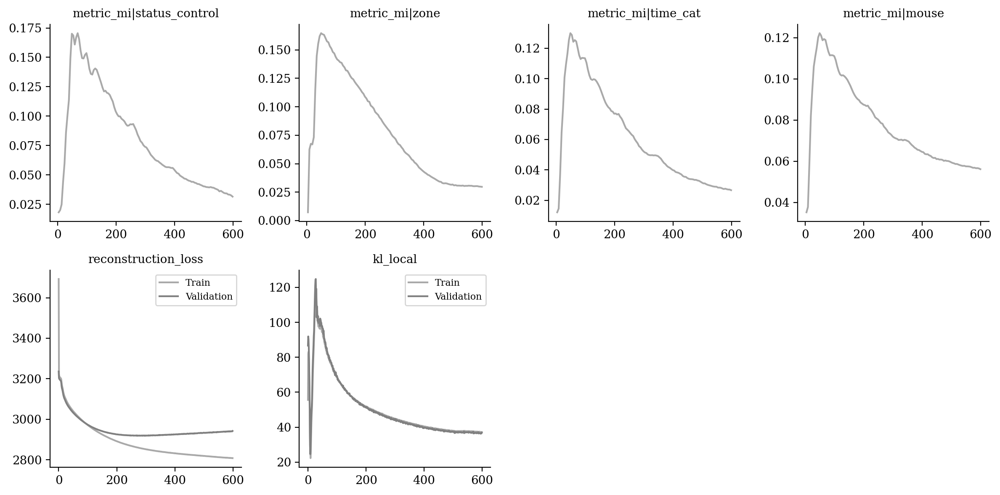

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

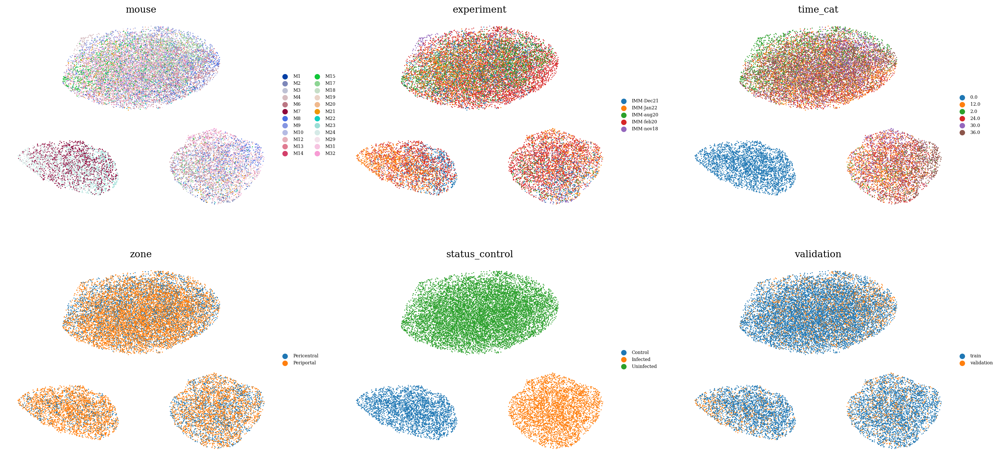

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

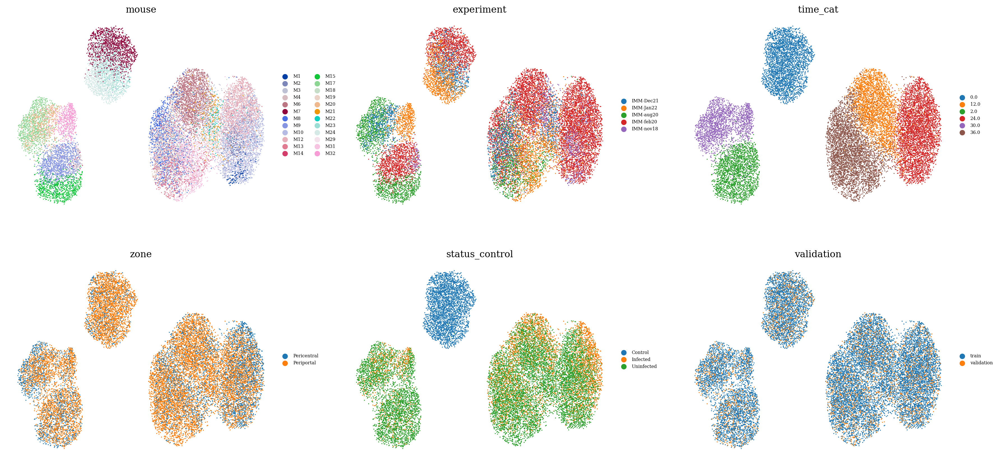

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

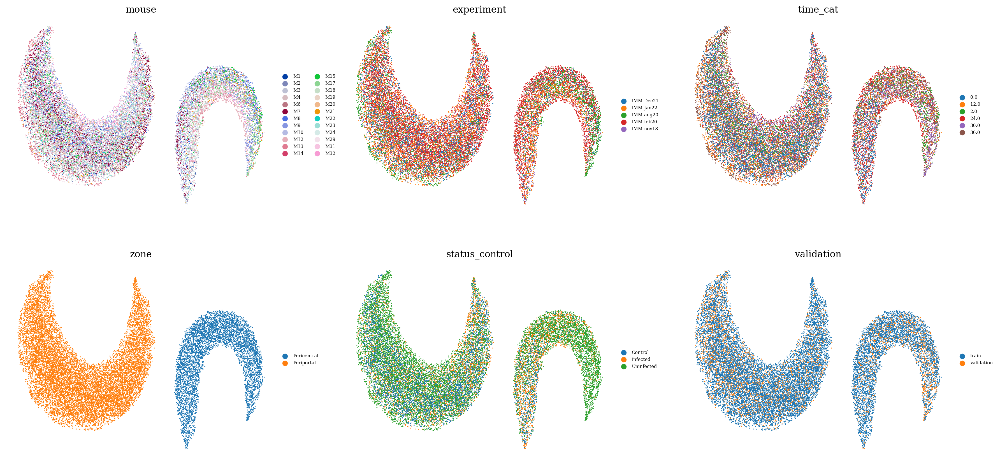

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

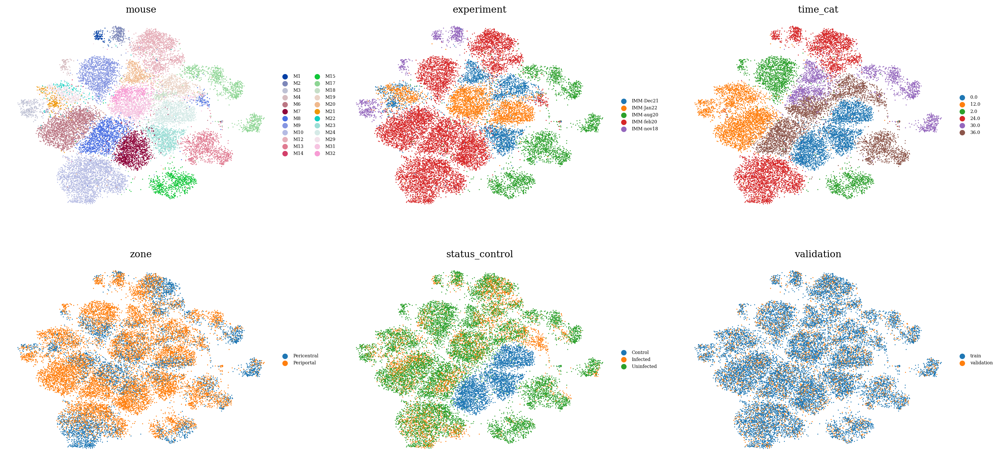

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

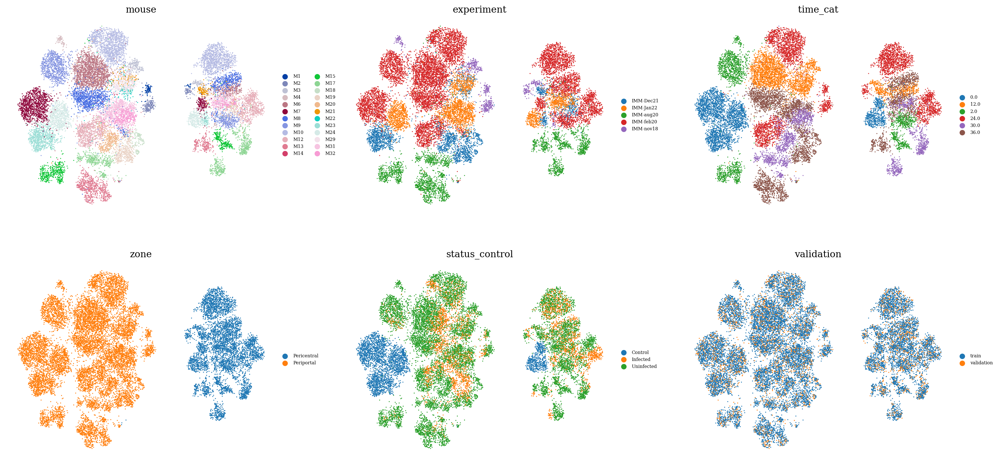

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

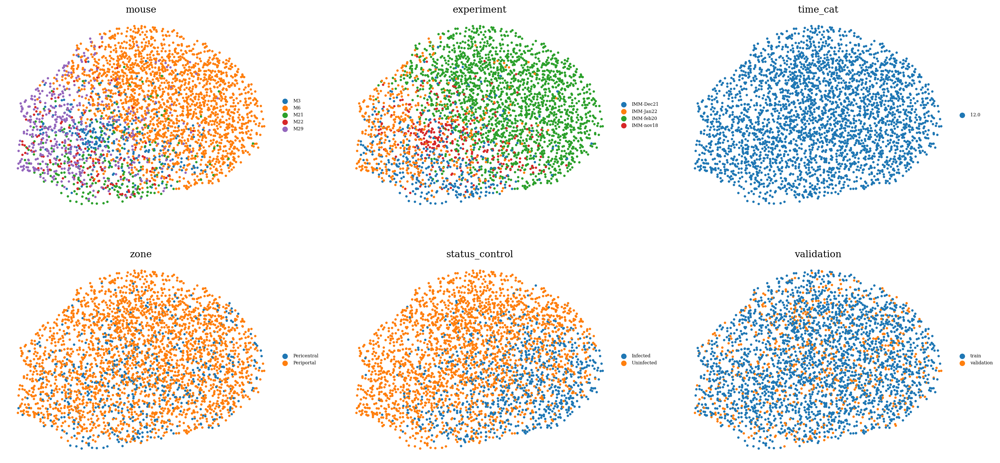

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )